In [0]:
from glob import glob
import os
import numpy as np
import matplotlib.pyplot as plt
import shutil
from torchvision import transforms
from torchvision import models
import torch
from torch.autograd import Variable
import torch.nn as nn
from torch.optim import lr_scheduler
from torch import optim
from torchvision.datasets import ImageFolder
from torchvision.utils import make_grid
import time
import torch.nn.functional as F
from sklearn.model_selection import train_test_split
import pandas as pd
from sklearn.metrics import *
import statistics

In [0]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
from fastai.vision import *
from fastai.vision.models import *

In [0]:
simple_transform = transforms.Compose([transforms.Resize((112,112),interpolation=3),
                                       transforms.ToTensor()])

In [0]:
train = ImageFolder('/content/drive/My Drive/Alvaro Train/',simple_transform)
test = ImageFolder('/content/drive/My Drive/Alvaro Test/',simple_transform)

In [0]:
name=""
path = F"/content/drive/My Drive/Colab Notebooks/Graphs/{name}"
def plot_graph(training_losses,val_losses,epochs,string,mode):
    plt.figure()
    plt.xlabel('Epoch')
    plt.ylabel(string)
    if mode=="plain":
      name = string + "model1.png"
      plt.title(string + 'per epoch - ' + "Simple classifier")
    if mode=="mixed":
      name = string + "model3.png"
      plt.title(string + 'per epoch - ' + "Mixed model")
    if mode=="subtractive":
      name = string + "model4.png"
      plt.title(string + 'per epoch - ' + "Subtractive feedback")
    if mode=="subtractive pre":
      name = string + "model5.png"
      plt.title(string + 'per epoch - ' + "Subtractive feedback using a pretrained classifier")
    if mode=="multiplicative":
      name = string + "model6.png"
      plt.title(string + 'per epoch - ' + "Multiplicative feedback")
    if mode=="multiplicative pre":
      name = string + "model7.png"
      plt.title(string + 'per epoch - ' + "Multiplicative feedback using a pretrained classifier")
    if mode=="plain genout":
      name = string + "model8.png"
      plt.title(string + 'per epoch - ' + "Simple classifier using 6-channel image")
    if mode=="feedback genout":
      name = string + "model9.png"
      plt.title(string + 'per epoch - ' + "Using gen output as a 2nd input channel")
    if mode=="feedback genout pre":
      name = string + "model10.png"
      plt.title(string + "Using gen output as a 2nd input channel using a pretrained classifier")  
    
    plt.plot(range(epochs),training_losses,label="Training " + string)
    plt.plot(range(epochs),val_losses,label="Validation " + string)
    plt.legend()
    plt.savefig(path+name)
    print(path+name)

In [0]:
use_cuda = torch.cuda.is_available()
torch.manual_seed(1)
np.random.seed(5)
classes = list(train.class_to_idx.keys())
device = torch.device("cuda" if use_cuda else "cpu")
epochs = 50
batch_size = 64
n_classes = 20
n_iterations = 10
ratio = 0.2

In [0]:
targets = train.targets
train_idx, valid_idx= train_test_split(np.arange(len(targets)),test_size=ratio,shuffle=True,stratify=targets)
train_sampler = torch.utils.data.SubsetRandomSampler(train_idx)
valid_sampler = torch.utils.data.SubsetRandomSampler(valid_idx)

trainloader = torch.utils.data.DataLoader(train, batch_size=64, sampler=train_sampler,num_workers=2)
valloader = torch.utils.data.DataLoader(train, batch_size=64, sampler=valid_sampler,num_workers=2)
testloader = torch.utils.data.DataLoader(test, batch_size=64, shuffle=True, num_workers=2)

In [0]:
train_examples = int((1.0-ratio)*len(train))
val_examples = int(ratio*len(train))
train_dataset, val_dataset = torch.utils.data.dataset.random_split(train,[train_examples,val_examples])
trainloader2 = torch.utils.data.DataLoader(train_dataset, batch_size=64, shuffle=True, num_workers=2)
valloader2 = torch.utils.data.DataLoader(val_dataset,batch_size=64,shuffle=True,num_workers=2)
testloader2 = torch.utils.data.DataLoader(test, batch_size=64, shuffle=True, num_workers=2)

In [0]:
classes_frame = pd.DataFrame(train.samples)
classes_frame.columns = ["filename","Class"]
classes_grouped = (classes_frame.groupby("Class").count()*(1-ratio)).astype("int")
classes_grouped.columns = ["Count"]
classes_grouped.index = classes
classes_grouped

,Count
bag,160
beer,160
book,160
case,160
coffee,160
cup,160
deodorant,160
eraser,160
hole,160
mouse,160


In [0]:
#class_total = list(0 for i in range(n_classes))
#for index,(images, labels) in enumerate(trainloader2):
  #for i in range(labels.size(0)):
      #label = labels[i]
      #class_total[label] += 1
#for i in range(n_classes):
    #print("{} Class count: {}".format(classes[i],class_total[i]))

In [0]:
#from fastai import *
#from fastai.vision.learner import model_meta
#from pathlib import Path
#import json
#from fastai.vision.models.unet import *
#f = resnet18
#def cut_model(m, cut):
    #return list(m.children())[:cut] if cut else [m]
#def get_encoder(f, cut):
    #base_model = (cut_model(f(True), cut))
    #return nn.Sequential(*base_model)
#cut, cut_lr = model_meta[f]
#body = create_body(resnet18, pretrained=False)
#unet = DynamicUnet(body,n_classes=20)
#model1 = proba()
#dynamicunet = DynamicUnet(model1.encoder,n_classes=20)

In [0]:
class Classifier(nn.Module):
    def __init__(self):
        super(Classifier, self).__init__()
        self.conv1 = nn.Conv2d(3, 32, 3, 1, 1, bias=False)
        self.conv1_bn = nn.BatchNorm2d(32)
        self.conv2 = nn.Conv2d(32, 64, 3, 1, 1, bias=False)
        self.conv2_bn = nn.BatchNorm2d(64)
        self.conv3 = nn.Conv2d(64, 128, 3, 1, 1, bias=False)
        self.conv4 = nn.Conv2d(128,256,3,1,1,bias=False)
        self.fc1 = nn.Linear(12544, 500)
        self.fc1_drop = nn.Dropout2d(p=0.5)
        self.fc2 = nn.Linear(500,256)
        self.fc2_drop = nn.Dropout2d(p=0.4)
        self.fc3 = nn.Linear(256,20)
        self.pool = nn.MaxPool2d(2)

    def forward(self, x):
        x = F.leaky_relu(self.pool(self.conv1_bn(self.conv1(x))))
        x = F.leaky_relu(self.pool(self.conv2_bn(self.conv2(x))))
        x = F.leaky_relu(self.pool(self.conv3(x)))
        x = F.leaky_relu(self.pool(self.conv4(x)))
        x = x.view(x.size(0),-1)
        x = F.leaky_relu(self.fc1_drop(self.fc1(x)))
        x = F.leaky_relu(self.fc2_drop(self.fc2(x)))
        x = self.fc3(x)
        return F.log_softmax(x, dim=1)

In [0]:
def train_validate(model,optimizer,criterion,mode):
  current = time.time()
  criterion1 = nn.MSELoss()
  model = model.cuda()
  stats = []
  training_losses = []
  val_losses = []
  train_accuracies = []
  val_accuracies = []
  for epoch in range(epochs):
    #train
      print("Epoch", epoch)
      model.train()
      train_epoch_loss = 0
      train_correct = 0
      for index, (images,labels) in enumerate(trainloader):
          images, labels = images.cuda(), labels.cuda()
      
          optimizer.zero_grad()
          if mode=="plain":
            predicted = model(images)
            loss = criterion(predicted,labels)
            loss.backward()
            train_epoch_loss += loss.item()
          
          elif mode=="plain genout":
            torch_zeros = torch.zeros(images.shape[0],3,112,112).cuda()
            stacked_images = torch.cat((images,torch_zeros),1)
            predicted = model(stacked_images)
            loss = criterion(predicted,labels)
            loss.backward()
            train_epoch_loss += loss.item()
            
          elif mode=="mixed":
            decoded, predicted = model(images)
            loss1 = criterion1(decoded,images)
            loss2 = criterion(predicted,labels)
            train_loss = loss2
            train_loss.backward()
            train_epoch_loss += train_loss.item()

          elif mode=="subtractive" or mode=="multiplicative":
            generated, predicted = model(images)
            alpha = 0.1
            for i in range(n_iterations):
              if mode=="subtractive":
                generated, predicted = model(images-generated*alpha)
              elif mode=="multiplicative":
                generated, predicted = model(images*generated*alpha)
              alpha = alpha + 0.1
            loss1 = criterion1(generated,images) 
            loss2 = criterion(predicted,labels)
            loss = loss2
            loss.backward()
            train_epoch_loss += loss.item()

          elif mode=="genout feedback":
            torch_zeros = torch.zeros(images.shape[0],3,112,112).cuda()
            stacked_images = torch.cat((images,torch_zeros),1)
            total_loss = 0
            for i in range(n_iterations):
              generated, predicted = model(stacked_images)
              stacked_images = torch.cat((images,generated),1)
            loss1 = criterion1(generated,images)
            loss2 = criterion(predicted,labels)
            loss = loss2
            loss.backward()
            train_epoch_loss += loss.item()


          optimizer.step()
          pred = predicted.max(1,keepdim=True)[1] # get the index of the max log-probability
          train_correct += pred.eq(labels.view_as(pred)).sum().item()
          
      train_epoch_loss /= len(trainloader)
      print('Average training loss: {:.4f}, Training Accuracy: {}/{} ({:.0f}%)'.format(
          train_epoch_loss, train_correct, len(train_idx),
          100. * train_correct / len(train_idx)))
      training_losses.append(train_epoch_loss)
      train_accuracies.append(100. * train_correct / len(train_idx))

      
    #validate
      model.eval()
      val_epoch_loss = 0
      val_correct = 0
      with torch.no_grad():
          for images, labels in valloader:
              images, labels = images.cuda(), labels.cuda()

              if mode=="plain":
                predicted = model(images)
                loss = criterion(predicted,labels)
                val_epoch_loss += loss.item()

              elif mode=="plain genout":
                torch_zeros = torch.zeros(images.shape[0],3,112,112).cuda()
                stacked_images = torch.cat((images,torch_zeros),1)
                predicted = model(stacked_images)
                loss = criterion(predicted,labels)
                val_epoch_loss += loss.item()
              
              elif mode=="mixed":
                decoded, predicted = model(images)
                criterion1 = nn.MSELoss()
                loss1 = criterion1(decoded,images)
                loss2 = criterion(predicted,labels)
                val_loss = loss1+loss2
                val_epoch_loss += val_loss.item()

            
              elif mode=="subtractive" or mode=="multiplicative":
                generated, predicted = model(images)
                alpha = 0.1
                total_loss = 0
                for i in range(n_iterations):
                  if mode=="subtractive":
                    generated, predicted = model(images-generated*alpha)
                  elif mode=="multiplicative":
                    generated, predicted = model(images*generated*alpha)
                  alpha = alpha + 0.1
                val_loss1 = criterion1(generated,images)
                val_loss2 = criterion(predicted,labels)
                val_loss = val_loss2
                val_epoch_loss += val_loss.item()

              elif mode=="genout feedback":
                torch_zeros = torch.zeros(images.shape[0],3,112,112).cuda()
                stacked_images = torch.cat((images,torch_zeros),1)
                total_loss = 0
                for i in range(n_iterations):
                  generated, predicted = model(stacked_images)
                  stacked_images = torch.cat((images,generated),1)
                val_loss1 = criterion1(generated,images)
                val_loss2 = criterion(predicted,labels)
                val_loss = val_loss2
                val_epoch_loss += val_loss.item()
  
              pred = predicted.max(1,keepdim=True)[1] # get the index of the max log-probability
              val_correct += pred.eq(labels.view_as(pred)).sum().item()
      
      val_epoch_loss /= len(valloader)
      print('Average validation loss: {:.4f}, Validation Accuracy: {}/{} ({:.0f}%)'.format(
          val_epoch_loss, val_correct, len(valid_idx),
          100. * val_correct / len(valid_idx)))
      val_losses.append(val_epoch_loss)
      val_accuracies.append(100. * val_correct / len(valid_idx))

  end = time.time()
  diff = end - current
  print("Training took %d seconds"% (diff) )
  print("Lowest validation loss", min(val_losses))
  print("Lowest training loss", min(training_losses))
  print("Highest training accuracy",max(train_accuracies))
  print("Highest validation accuracy",max(val_accuracies))
  stats.append(training_losses)
  stats.append(train_accuracies)
  stats.append(val_losses)
  stats.append(val_accuracies)
  return model, stats

In [0]:
def test_model(model,criterion,mode):
  model.eval()
  criterion1 = nn.MSELoss()
  test_epoch_loss = 0
  test_correct = 0
  class_correct = list(0 for i in range(n_classes))
  class_total = list(0 for i in range(n_classes))

  predlist=torch.zeros(0,dtype=torch.long, device='cpu')
  labelslist=torch.zeros(0,dtype=torch.long, device='cpu')

  with torch.no_grad():
      accuracies = [[] for i in range(n_iterations)]
      for index,(images, labels) in enumerate(testloader):
            images, labels = images.cuda(), labels.cuda()

            if mode=="plain":
              predicted = model(images)
              loss = criterion(predicted,labels)
              test_epoch_loss += loss.item()
            
            elif mode=="plain genout":
              torch_zeros = torch.zeros(images.shape[0],3,112,112).cuda()
              stacked_images = torch.cat((images,torch_zeros),1)
              predicted = model(stacked_images)
              loss = criterion(predicted,labels)
              test_epoch_loss += loss.item()
            
            elif mode=="mixed":
              decoded, predicted = model(images)
              criterion1 = nn.MSELoss()
              loss1 = criterion1(decoded,images)
              loss2 = criterion(predicted,labels)
              loss = loss1 + loss2
              test_epoch_loss += loss.item()

            elif mode=="subtractive" or mode=="multiplicative":
                criterion1 = nn.MSELoss()
                generated, predicted = model(images)
                alpha = 0.1
                for i in range(n_iterations):
                  iteration_correct = 0
                  if mode=="subtractive":
                    generated, predicted = model(images-generated*alpha)
                  elif mode=="multiplicative":
                    generated, predicted = model(images*generated*alpha)
                  alpha = alpha + 0.1
                

                  pred_it = predicted.max(1, keepdim=True)[1]
                  iteration_correct += pred_it.eq(labels.view_as(pred_it)).sum().item()
                  accuracies[i] = accuracies[i] + [100.*iteration_correct/len(images)]
                
                loss1 = criterion1(generated,images)
                loss2 = criterion(predicted,labels)
                loss = loss2
                test_epoch_loss += loss.item()

            elif mode=="genout feedback":
                torch_zeros = torch.zeros(images.shape[0],3,112,112).cuda()
                stacked_images = torch.cat((images,torch_zeros),1)
                for i in range(n_iterations):
                  iteration_correct = 0
                  generated, predicted = model(stacked_images)
                  stacked_images = torch.cat((images,generated),1)
                  

                  pred_it = predicted.max(1, keepdim=True)[1]
                  iteration_correct += pred_it.eq(labels.view_as(pred_it)).sum().item()
                  accuracies[i] = accuracies[i] + [100.*iteration_correct/len(images)]

                loss1 = criterion1(generated,images)
                loss2 = criterion(predicted,labels)
                loss = loss2
                test_epoch_loss += loss.item()


            _, predicted_l = torch.max(predicted.data, 1)
            test_correct += (predicted_l == labels).sum().item()
            c = (predicted_l == labels).squeeze()

            predlist=torch.cat([predlist,predicted_l.view(-1).cpu()])
            labelslist=torch.cat([labelslist,labels.view(-1).cpu()])

            for i in range(labels.size(0)):
              label = labels[i]
              class_correct[label] += c[i].item()
              class_total[label] += 1
  test_epoch_loss /= len(testloader)
  print('\nTest loss: {:.4f} \nTesting Accuracy: {}/{} ({:.0f}%)'.format(
      test_epoch_loss, test_correct, len(testloader.dataset),
        100. * test_correct / len(testloader.dataset)))
  for i in range(n_classes):
      print("{} Class Accuracy: {}/{} ({:.1f}%)".format(classes[i],class_correct[i],class_total[i],100*class_correct[i]/class_total[i]))

  conf_matrix=confusion_matrix(labelslist.numpy(), predlist.numpy())
  print(conf_matrix)
  return accuracies
  

In [0]:
def accuracy_per_iteration(accuracies,mode):
  plt.rcParams["figure.figsize"] = (6,4)
  plt.figure()
  if mode=="subtractive":
      name = "accperit_" + "model4.png"
      plt.title("Accuracy per epoch" + "Subtractive feedback")
  if mode=="subtractive pre":
      name = "accperit_" + "model5.png"
      plt.title("Accuracy per epoch" + "Subtractive feedback with pretrained classifier")
  if mode=="multiplicative":
      name = "accperit_" + "model6.png"
      plt.title("Accuracy per epoch" + "Multiplicative feedback")
  if mode=="multiplicative pre":
      name = "accperit_" + "model7.png"
      plt.title("Accuracy per epoch" + "Multiplicative feedback with pretrained classifier")
  if mode=="genout feedback":
      name = "accperit_" + "model9.png"
      plt.title("Accuracy per epoch" + "Using gen out as a second input channel")
  if mode=="genout feedback pre":
      name = "accperit_" + "model10.png"
      plt.title("Accuracy per epoch" + "Using gen out as a second input channel with pretrained classifier")
  for i, el in enumerate(accuracies):
    accuracies[i] = sum(el)/len(testloader)
  print(accuracies)
  plt.plot(range(n_iterations),accuracies)
  plt.title("Accuracy per iteration")
  plt.xticks(range(n_iterations))
  plt.xlabel("Iteration")
  plt.ylabel("Accuracy")
  plt.savefig(path+name)
  print(path+name)

In [0]:
def show_examples(model,mode):
  model.eval()
  plt.rcParams["figure.figsize"] = (20,3)
  test_images, labels = next(iter(testloader))
  test_images = test_images.cuda()
  if mode!="genout feedback":
    generated, test_output = model(test_images)
  alpha = 0.1
  for i in range(n_iterations):
    if mode=="subtractive":
      generated,test_output = model(test_images-generated*alpha)
    if mode=="multiplicative":
      generated,test_output = model(test_images*generated*alpha)
    if mode=="genout feedback":
      torch_zeros = torch.zeros(test_images.shape[0],3,112,112).cuda()
      stacked_images = torch.cat((test_images,torch_zeros),1)
      for i in range(n_iterations):
        generated,predicted = model(stacked_images)
        stacked_images = torch.cat((test_images,generated),1)

    alpha = alpha + 0.1

  for i in range(len(test_images)):
    if mode=="genout feedback":
      fig = plt.figure()
      plot = fig.add_subplot(1, 2, 1)
      plot.set_title('Original Image')
      image_input = np.transpose(test_images[i].cpu(),(1,2,0))
      image_output = np.transpose(generated[i].cpu().detach(),(1,2,0))
      imgplot = plt.imshow(image_input)
      plot = fig.add_subplot(1, 2, 2)
      plot.set_title('Generated Image')
      plt.imshow(np.clip(image_output,0,1))
      plt.show()

    else:
      fig = plt.figure()
      plot = fig.add_subplot(1, 3, 1)
      plot.set_title('Original Image')
      image_input = np.transpose(test_images[i].cpu(),(1,2,0))
      image_output = np.transpose(generated[i].cpu().detach(),(1,2,0))
      imgplot = plt.imshow(image_input)
      plot = fig.add_subplot(1, 3, 2)
      plot.set_title('Generated Image')
      plt.imshow(np.clip(image_output,0,1))
      plot = fig.add_subplot(1,3,3)
      difference = np.transpose(test_images[i].cpu(),(1,2,0)) - np.transpose(generated[i].cpu().detach(),(1,2,0))
      plot.set_title("Input to network")
      plt.imshow(np.clip(difference,0,1))
      plt.show()

In [0]:
current = time.time()
for index, (images,labels) in enumerate(trainloader):
  if index==48:
    print(index)
end = time.time()
print(end-current)

48
682.6365911960602


# Vanilla classifier training

In [0]:
model1 = Classifier().cuda()
optimizer = optim.Adam(model1.parameters(),lr=0.001)
criterion = nn.CrossEntropyLoss()
model1,model1_stats = train_validate(model1,optimizer,criterion,"plain")

Epoch 0
Average training loss: 2.5581, Training Accuracy: 563/3200 (18%)
Average validation loss: 2.0081, Validation Accuracy: 322/800 (40%)
Epoch 1
Average training loss: 1.5632, Training Accuracy: 1566/3200 (49%)
Average validation loss: 1.1279, Validation Accuracy: 499/800 (62%)
Epoch 2
Average training loss: 0.9373, Training Accuracy: 2204/3200 (69%)
Average validation loss: 0.6666, Validation Accuracy: 646/800 (81%)
Epoch 3
Average training loss: 0.6066, Training Accuracy: 2568/3200 (80%)
Average validation loss: 0.5865, Validation Accuracy: 653/800 (82%)
Epoch 4
Average training loss: 0.4284, Training Accuracy: 2761/3200 (86%)
Average validation loss: 0.3471, Validation Accuracy: 708/800 (88%)
Epoch 5
Average training loss: 0.2907, Training Accuracy: 2914/3200 (91%)
Average validation loss: 0.2756, Validation Accuracy: 727/800 (91%)
Epoch 6
Average training loss: 0.1721, Training Accuracy: 3019/3200 (94%)
Average validation loss: 0.2173, Validation Accuracy: 755/800 (94%)
Epoch 7

In [0]:
test_model(model1,criterion,"plain")


Test loss: 0.4468 
Testing Accuracy: 741/800 (93%)
bag Class Accuracy: 36/40 (90.0%)
beer Class Accuracy: 39/40 (97.5%)
book Class Accuracy: 39/40 (97.5%)
case Class Accuracy: 40/40 (100.0%)
coffee Class Accuracy: 37/40 (92.5%)
cup Class Accuracy: 37/40 (92.5%)
deodorant Class Accuracy: 40/40 (100.0%)
eraser Class Accuracy: 37/40 (92.5%)
hole Class Accuracy: 37/40 (92.5%)
mouse Class Accuracy: 30/40 (75.0%)
mug Class Accuracy: 36/40 (90.0%)
sleep Class Accuracy: 36/40 (90.0%)
speaker Class Accuracy: 35/40 (87.5%)
spray Class Accuracy: 37/40 (92.5%)
stapler Class Accuracy: 38/40 (95.0%)
tape Class Accuracy: 37/40 (92.5%)
tea Class Accuracy: 38/40 (95.0%)
tissues Class Accuracy: 38/40 (95.0%)
umbrella Class Accuracy: 38/40 (95.0%)
watch Class Accuracy: 36/40 (90.0%)
[[36  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  4  0]
 [ 0 39  0  0  0  0  0  0  0  0  0  0  0  1  0  0  0  0  0  0]
 [ 0  0 39  0  0  0  0  0  0  0  0  0  0  1  0  0  0  0  0  0]
 [ 0  0  0 40  0  0  0  0  0  0  0 

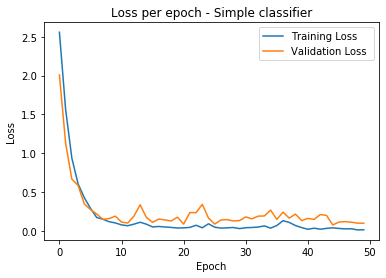

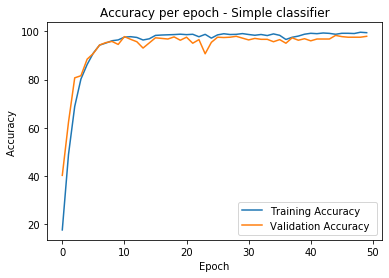

In [0]:
plt.rcParams["figure.figsize"] = (6,4)
plot_graph(model1_stats[0],model1_stats[2],epochs,"Loss ","plain")
plot_graph(model1_stats[1],model1_stats[3],epochs,"Accuracy ","plain")

In [0]:
name = "alvaro_model1_classier_plain.pth"
path = F"/content/drive/My Drive/Colab Notebooks/Alvaro/{name}"
torch.save(model1.state_dict(), path)

In [0]:
mean_train_loss = statistics.mean(model1_stats[0]) #0.179620
val_train_loss = statistics.mean(model1_stats[2]) #0.245299
print(mean_train_loss)
print(val_train_loss)

0.17962026815278515
0.24529906384253572


In [0]:
print("Training losses",model1_stats[0])
print("Training accuracies",model1_stats[1])
print("Val losses",model1_stats[2])
print("Val acc",model1_stats[3])

Training losses [2.558127751350403, 1.5631550812721253, 0.9373362326622009, 0.606590879559517, 0.4284420111775398, 0.2906880430877209, 0.17213233232498168, 0.14992949340492487, 0.11792891148477792, 0.10221346855163574, 0.0766730250697583, 0.06621054934337735, 0.08657124021090568, 0.11093040028586984, 0.08593109115958214, 0.050591981960460546, 0.056617440017871556, 0.05000274288468063, 0.044332856163382534, 0.03642028053523973, 0.03879213259089738, 0.04458452649530955, 0.07224500048207119, 0.039502237000269814, 0.0909667461272329, 0.04727900701458566, 0.03575019480951596, 0.0392378591618035, 0.04347876664192882, 0.0290540663379943, 0.04063199060270563, 0.04358619339647703, 0.049342956852633506, 0.06409383663441987, 0.03499679747765185, 0.06853394751989982, 0.13129764362296556, 0.10872839349671266, 0.06854888385190862, 0.04234236297372263, 0.020334954095014835, 0.03427945700168493, 0.021604530403128593, 0.03171362774563022, 0.03914409972072463, 0.03113563514256384, 0.02562424602554529, 0

# Autoencoder

In [0]:
class AutoEncoder(nn.Module):
    def __init__(self):
        super(AutoEncoder, self).__init__()
        self.conv1 = nn.Conv2d(3, 32, 3, 1, 1, bias=False)
        self.conv2 = nn.Conv2d(32, 64, 3, 1, 1, bias=False)
        self.conv3 = nn.Conv2d(64, 128, 3, 1, 1, bias=False)
        self.conv4 = nn.Conv2d(128,256,3,1,1,bias=False)
        self.deconv1 = nn.ConvTranspose2d(256,128,2,2,0,bias=False)
        self.deconv2 = nn.ConvTranspose2d (128, 64, 2, 2, 0, bias=False)
        self.deconv3 = nn.ConvTranspose2d (64, 32, 2, 2, 0, bias=False)
        self.deconv4 = nn.ConvTranspose2d (32, 3, 2, 2, 0, bias=False)
        self.pool = nn.MaxPool2d(2)

    def forward(self, x):
        x = F.relu(self.pool(self.conv1(x)))
        x = F.relu(self.pool(self.conv2(x)))
        x = F.relu(self.pool(self.conv3(x)))
        encoded = F.relu(self.pool(self.conv4(x)))
        decoded = F.relu(self.deconv1(encoded))
        decoded = F.relu(self.deconv2(decoded))
        decoded = F.relu(self.deconv3(decoded))
        decoded = F.relu(self.deconv4(decoded))
        return torch.tanh(decoded)

In [0]:
model2 = AutoEncoder().cuda()
optimizer = optim.Adam(model2.parameters(),lr=0.001)
criterion = nn.MSELoss()
training_losses = []
val_losses = []
for epoch in range(epochs):
    #train
    print("Epoch", epoch)
    model2.train()
    train_epoch_loss = 0
    for index, (images,labels) in enumerate(trainloader):
        images, labels = images.cuda(), labels.cuda()
        optimizer.zero_grad()
        auto_train_output = model2(images)
        loss = criterion(auto_train_output,images)
        loss.backward()
        train_epoch_loss += loss.item()
        optimizer.step()
    train_epoch_loss /= len(trainloader)
    print("Average training loss:",train_epoch_loss)
    training_losses.append(train_epoch_loss)
    
    #validate
    model2.eval()
    val_epoch_loss = 0
    with torch.no_grad():
        for images, labels in valloader:
            images, labels = images.cuda(), labels.cuda()
            auto_val_output = model2(images)
            loss = criterion(auto_val_output,images)
            val_epoch_loss += loss.item()
    val_epoch_loss /= len(valloader)
    print('Average validation loss: {:.4f}'.format(val_epoch_loss))
    val_losses.append(val_epoch_loss)

    #scheduler.step()

Epoch 0
Average training loss: 0.06833340764045716
Average validation loss: 0.0325
Epoch 1
Average training loss: 0.023277848586440088
Average validation loss: 0.0167
Epoch 2
Average training loss: 0.012722523845732213
Average validation loss: 0.0092
Epoch 3


In [0]:
name = "alvaro_autoencoder.pth"
path = F"/content/drive/My Drive/Colab Notebooks/Alvaro/{name}"
torch.save(model2.state_dict(), path)

In [0]:
auto_train_loss = statistics.mean(training_losses) #005123550043720752
auto_val_loss = statistics.mean(val_losses) #0.004230056810909166
print(auto_train_loss)
print(auto_val_loss)

0.005123550043720752
0.004230056810909166


In [0]:
model2.eval()
test_epoch_loss = 0
with torch.no_grad():
      for images, labels in testloader:
          images, labels = images.cuda(), labels.cuda()
          auto_test_output = model2(images)
          loss = criterion(auto_test_output,images)
          test_epoch_loss += loss.item()
test_epoch_loss /= len(testloader)
print('Average testing loss: {:.4f}'.format(test_epoch_loss))

Average testing loss: 0.0025


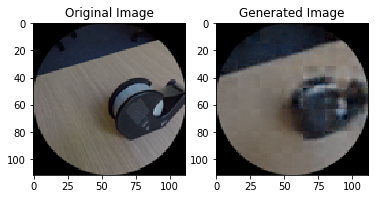

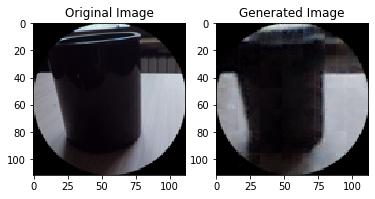

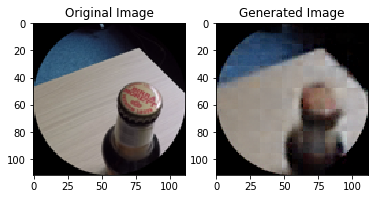

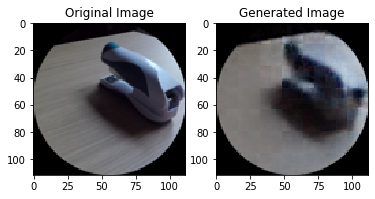

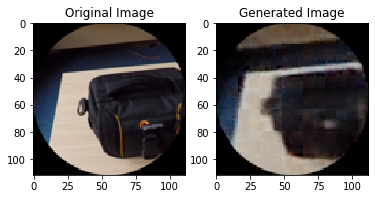

...

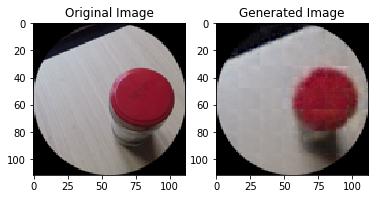

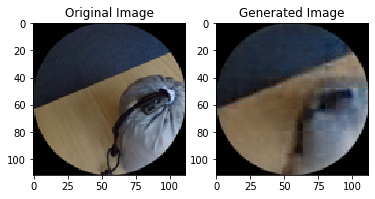

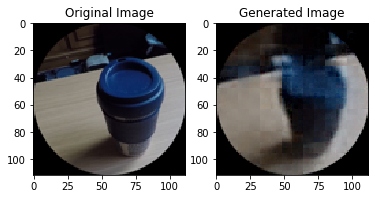

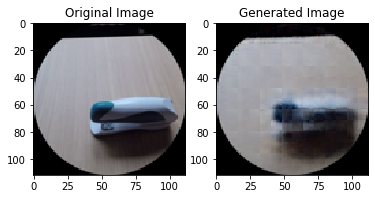

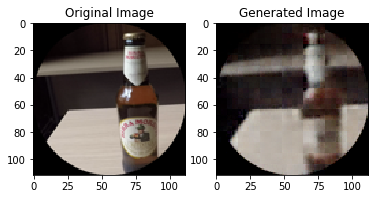

In [0]:
test_images, labels = next(iter(testloader))
test_images = test_images.cuda()
test_output = model2(test_images)

for i in range(len(test_images)):
    fig = plt.figure()
    plot = fig.add_subplot(1, 2, 1)
    plot.set_title('Original Image')
    image_input = test_images[i]
    image_input = np.transpose(test_images[i].cpu(),(1,2,0))
    image_output = test_output[i]
    image_output = np.transpose(test_output[i].cpu().detach(),(1,2,0))
    imgplot = plt.imshow(image_input)
    plot = fig.add_subplot(1, 2, 2)
    plot.set_title('Generated Image')
    imgplot = plt.imshow(image_output)
    plt.show()

# Mixed model with no feedback

In [0]:
model1 = Classifier().cuda()
name = "alvaro_model1_classier_plain.pth"
path = F"/content/drive/My Drive/Colab Notebooks/Alvaro/{name}"
model1.load_state_dict(torch.load(path))

<All keys matched successfully>

In [0]:
class Mixed(nn.Module):
    def __init__(self):
        super(Mixed, self).__init__()

        self.conv1 = nn.Conv2d(3, 32, 3, 1, 1, bias=False)
        self.conv1_bn = nn.BatchNorm2d(32)
        self.conv2 = nn.Conv2d(32, 64, 3, 1, 1, bias=False)
        self.conv2_bn = nn.BatchNorm2d(64)
        self.conv3 = nn.Conv2d(64, 128, 3, 1, 1, bias=False)
        self.conv4 = nn.Conv2d(128,256,3,1,1,bias=False)
        self.deconv1 = nn.ConvTranspose2d(256,128,2,2,0,bias=False)
        self.deconv2 = nn.ConvTranspose2d (128, 64, 2, 2, 0, bias=False)
        self.deconv3 = nn.ConvTranspose2d (64, 32, 2, 2, 0, bias=False)
        self.deconv4 = nn.ConvTranspose2d (32, 3, 2, 2, 0, bias=False)
        self.fc1 = nn.Linear(12544, 500)
        self.fc1_drop = nn.Dropout2d(p=0.5)
        self.fc2 = nn.Linear(500,256)
        self.fc2_drop = nn.Dropout2d(p=0.4)
        self.fc3 = nn.Linear(256,20)
        self.pool = nn.MaxPool2d(2)

    def forward(self,x):
        x = F.leaky_relu(self.pool(self.conv1_bn(self.conv1(x))))
        x = F.leaky_relu(self.pool(self.conv2_bn(self.conv2(x))))
        x = F.leaky_relu(self.pool(self.conv3(x)))
        encoded = F.leaky_relu(self.pool(self.conv4(x)))
        decoded = F.leaky_relu(self.deconv1(encoded))
        decoded = F.leaky_relu(self.deconv2(decoded))
        decoded = F.leaky_relu(self.deconv3(decoded))
        decoded = F.leaky_relu(self.deconv4(decoded))
        flattened = encoded.view(encoded.size(0),-1)
        predicted = F.leaky_relu(self.fc1_drop(self.fc1(flattened)))
        predicted = F.leaky_relu(self.fc2_drop(self.fc2(predicted)))
        predicted = self.fc3(predicted)
        return torch.tanh(decoded), F.log_softmax(predicted, dim=1)

In [0]:
model3 = Mixed().to(device)
optimizer = optim.Adam(model3.parameters(),lr=0.001)
criterion = nn.CrossEntropyLoss()
model3, model3_stats = train_validate(model3,optimizer,criterion,"mixed")

Epoch 0
Average training loss: 2.6873, Training Accuracy: 623/3200 (19%)
Average validation loss: 2.0912, Validation Accuracy: 273/800 (34%)
Epoch 1
Average training loss: 1.5344, Training Accuracy: 1612/3200 (50%)
Average validation loss: 0.9655, Validation Accuracy: 573/800 (72%)
Epoch 2
Average training loss: 0.9893, Training Accuracy: 2177/3200 (68%)
Average validation loss: 0.6440, Validation Accuracy: 646/800 (81%)
Epoch 3
Average training loss: 0.6867, Training Accuracy: 2543/3200 (79%)
Average validation loss: 0.5100, Validation Accuracy: 683/800 (85%)
Epoch 4
Average training loss: 0.4587, Training Accuracy: 2734/3200 (85%)
Average validation loss: 0.5690, Validation Accuracy: 662/800 (83%)
Epoch 5
Average training loss: 0.3662, Training Accuracy: 2822/3200 (88%)
Average validation loss: 0.2603, Validation Accuracy: 743/800 (93%)
Epoch 6
Average training loss: 0.2339, Training Accuracy: 2981/3200 (93%)
Average validation loss: 0.2065, Validation Accuracy: 754/800 (94%)
Epoch 7

In [0]:
test_model(model3,criterion,"mixed")


Test loss: 0.7121 
Testing Accuracy: 700/800 (88%)
bag Class Accuracy: 38/40 (95.0%)
beer Class Accuracy: 37/40 (92.5%)
book Class Accuracy: 38/40 (95.0%)
case Class Accuracy: 30/40 (75.0%)
coffee Class Accuracy: 37/40 (92.5%)
cup Class Accuracy: 38/40 (95.0%)
deodorant Class Accuracy: 40/40 (100.0%)
eraser Class Accuracy: 33/40 (82.5%)
hole Class Accuracy: 35/40 (87.5%)
mouse Class Accuracy: 30/40 (75.0%)
mug Class Accuracy: 31/40 (77.5%)
sleep Class Accuracy: 38/40 (95.0%)
speaker Class Accuracy: 25/40 (62.5%)
spray Class Accuracy: 33/40 (82.5%)
stapler Class Accuracy: 38/40 (95.0%)
tape Class Accuracy: 35/40 (87.5%)
tea Class Accuracy: 34/40 (85.0%)
tissues Class Accuracy: 40/40 (100.0%)
umbrella Class Accuracy: 32/40 (80.0%)
watch Class Accuracy: 38/40 (95.0%)
[[38  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  2  0]
 [ 0 37  0  0  0  0  1  0  0  0  1  1  0  0  0  0  0  0  0  0]
 [ 0  2 38  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0 30  3  0  0  7  0  0  0 

In [0]:
name = "alvaro_model3_mixed.pth"
path = F"/content/drive/My Drive/Colab Notebooks/Alvaro/{name}"
torch.save(model3.state_dict(), path)

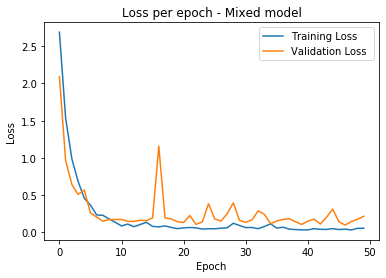

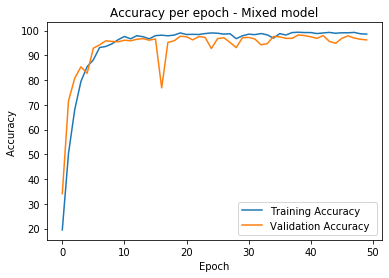

In [0]:
plt.rcParams["figure.figsize"] = (6,4)
plot_graph(model3_stats[0],model3_stats[2],epochs,"Loss ","mixed")
plot_graph(model3_stats[1],model3_stats[3],epochs,"Accuracy ","mixed")

In [0]:
print("Training losses",model3_stats[0])
print("Training accuracies",model3_stats[1])
print("Val losses",model3_stats[2])
print("Val acc",model3_stats[3])

Training losses [2.6873383569717406, 1.534406247138977, 0.9893186962604523, 0.6866825038194656, 0.45872857570648196, 0.3661614102125168, 0.23394044637680053, 0.22946795508265494, 0.18058464027941226, 0.13510092459619044, 0.08642967365682125, 0.11226669639348984, 0.07670937038958073, 0.10588651176542044, 0.135513188354671, 0.08068609245121479, 0.07420550011098385, 0.08678892739117146, 0.06687126185745002, 0.05053846534341574, 0.06066110905259848, 0.06582399493083357, 0.061071561127901075, 0.04503272710368037, 0.04852811297401786, 0.049010477904230354, 0.056864919774234295, 0.06161102479323745, 0.12287717569619418, 0.09248277179896831, 0.06473695397377015, 0.06595664832741022, 0.04962368957698345, 0.07912479095160961, 0.11448016319423913, 0.05791794264689088, 0.0698585637100041, 0.045178780630230904, 0.03799910992383957, 0.034371012914925815, 0.033808893859386444, 0.04959594747051597, 0.04120039509609342, 0.04013403562828898, 0.050711255595088, 0.03844848334789276, 0.043674288243055345, 

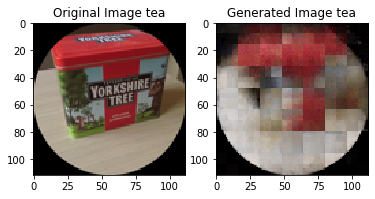

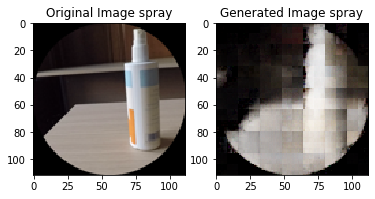

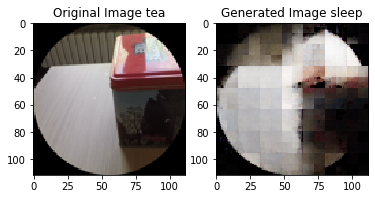

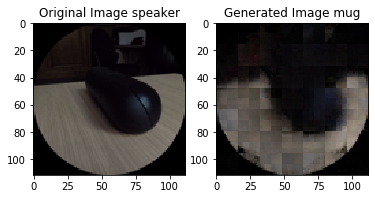

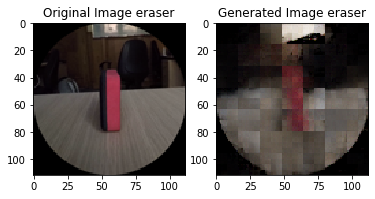

...

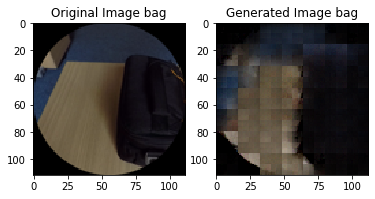

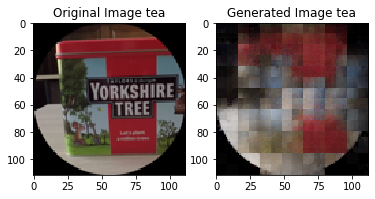

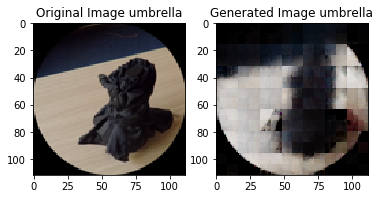

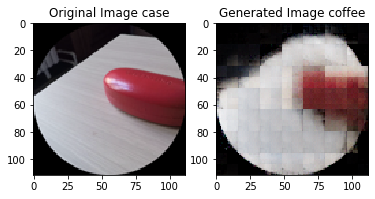

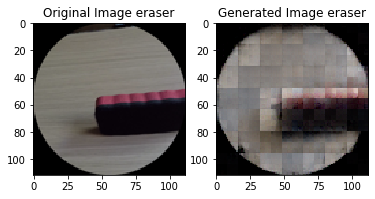

In [0]:
test_images, labels = next(iter(testloader))
test_images = test_images.cuda()
test_output, predicted = model3(test_images)
_, pred_label = torch.max(predicted.data, 1)

for i in range(len(test_images)):
    fig = plt.figure()
    plot = fig.add_subplot(1, 2, 1)
    plot.set_title('Original Image ' + classes[labels[i]])
    image_input = test_images[i]
    image_input = np.transpose(test_images[i].cpu(),(1,2,0))
    image_output = test_output[i]
    image_output = np.transpose(test_output[i].cpu().detach(),(1,2,0))
    imgplot = plt.imshow(image_input)
    plot = fig.add_subplot(1, 2, 2)
    plot.set_title('Generated Image ' + classes[pred_label[i]])
    imgplot = plt.imshow(np.clip(image_output,0,1))
    plt.show()

# Subtractive feedback trained from scratch

In [0]:
model4 = Mixed().to(device)
optimizer = optim.Adam(model4.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss()
model4, model4_stats = train_validate(model4,optimizer,criterion,"subtractive")

Epoch 0


Exception ignored in: <bound method _MultiProcessingDataLoaderIter.__del__ of <torch.utils.data.dataloader._MultiProcessingDataLoaderIter object at 0x7f52378927b8>>
Traceback (most recent call last):
  File "/usr/local/lib/python3.6/dist-packages/torch/utils/data/dataloader.py", line 961, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.6/dist-packages/torch/utils/data/dataloader.py", line 941, in _shutdown_workers
    w.join()
  File "/usr/lib/python3.6/multiprocessing/process.py", line 124, in join
    res = self._popen.wait(timeout)
  File "/usr/lib/python3.6/multiprocessing/popen_fork.py", line 50, in wait
    return self.poll(os.WNOHANG if timeout == 0.0 else 0)
  File "/usr/lib/python3.6/multiprocessing/popen_fork.py", line 28, in poll
    pid, sts = os.waitpid(self.pid, flag)
KeyboardInterrupt: 


RuntimeError: ignored

In [0]:
name = "alvaro_model4_mixed_subtr.pth"
path = F"/content/drive/My Drive/Colab Notebooks/Alvaro/{name}"
torch.save(model4.state_dict(), path)

/content/drive/My Drive/Colab Notebooks/Graphs/Loss model4.png
/content/drive/My Drive/Colab Notebooks/Graphs/Accuracy model4.png


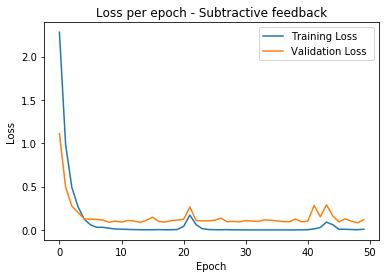

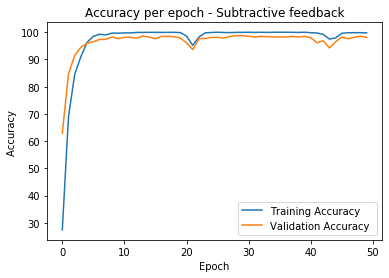

In [0]:
plt.rcParams["figure.figsize"] = (6,4)
plot_graph(model4_stats[0],model4_stats[2],epochs,"Loss ","subtractive")
plot_graph(model4_stats[1],model4_stats[3],epochs,"Accuracy ","subtractive")

In [0]:
accuracies_model4 = test_model(model4,criterion,"subtractive")


Test loss: 0.4093 
Testing Accuracy: 737/800 (92%)
bag Class Accuracy: 36/40 (90.0%)
beer Class Accuracy: 39/40 (97.5%)
book Class Accuracy: 38/40 (95.0%)
case Class Accuracy: 39/40 (97.5%)
coffee Class Accuracy: 38/40 (95.0%)
cup Class Accuracy: 39/40 (97.5%)
deodorant Class Accuracy: 38/40 (95.0%)
eraser Class Accuracy: 35/40 (87.5%)
hole Class Accuracy: 38/40 (95.0%)
mouse Class Accuracy: 33/40 (82.5%)
mug Class Accuracy: 38/40 (95.0%)
sleep Class Accuracy: 34/40 (85.0%)
speaker Class Accuracy: 31/40 (77.5%)
spray Class Accuracy: 34/40 (85.0%)
stapler Class Accuracy: 38/40 (95.0%)
tape Class Accuracy: 37/40 (92.5%)
tea Class Accuracy: 39/40 (97.5%)
tissues Class Accuracy: 39/40 (97.5%)
umbrella Class Accuracy: 35/40 (87.5%)
watch Class Accuracy: 39/40 (97.5%)
[[36  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  4  0]
 [ 0 39  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1  0]
 [ 0  1 38  0  0  1  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0 39  0  0  0  1  0  0  0  0

[90.14423076923077, 90.7451923076923, 90.86538461538461, 91.22596153846153, 91.46634615384616, 91.70673076923077, 91.94711538461539, 92.0673076923077, 92.3076923076923, 92.1875]
/content/drive/My Drive/Colab Notebooks/Graphs/accperit_model4.png


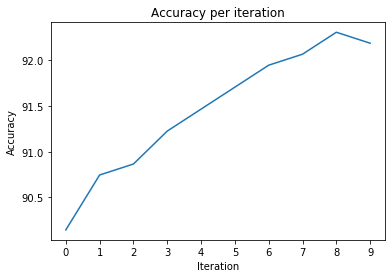

In [0]:
accuracy_per_iteration(accuracies_model4,"subtractive")

In [0]:
print("Training losses",model4_stats[0])
print("Training accuracies",model4_stats[1])
print("Val losses",model4_stats[2])
print("Val acc",model4_stats[3])

Training losses [2.2801204552650454, 0.9821267703771589, 0.49093897128105163, 0.26654387368261806, 0.1229229279309511, 0.059169284940697266, 0.030577402022201577, 0.03070756603142945, 0.01995893895195331, 0.011100466521631462, 0.008976636929932284, 0.006385883926181124, 0.003897131610719953, 0.002662095400690304, 0.0018981054059950104, 0.002776584721255858, 0.0035839581644413537, 0.0020817417776670473, 0.0021088574686828, 0.005384985255133871, 0.041411574851365006, 0.1716228160373867, 0.0619301808993332, 0.014179122371308039, 0.005133208444523915, 0.0028076386254206227, 0.0018224571049279348, 0.0036636363590623663, 0.001101459385856515, 0.0010304665123342146, 0.0008075030628324384, 0.0007251543825386762, 0.00048823520207758964, 0.0008694839030637242, 0.0004407880105155186, 0.000789880399064884, 0.0006318884299839737, 0.000375150345919792, 0.0006804699673132006, 0.0011254085122059223, 0.0027708250521777705, 0.01179874068429217, 0.028657678065072103, 0.09003747942473274, 0.06023090158635

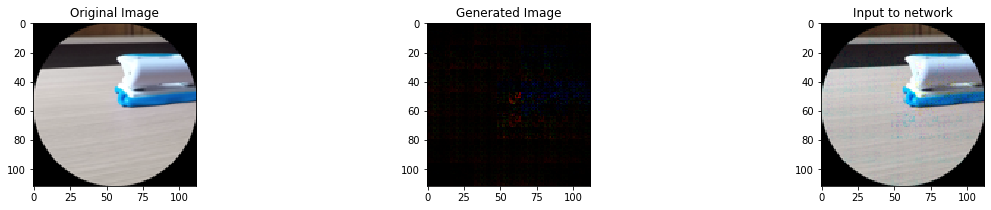

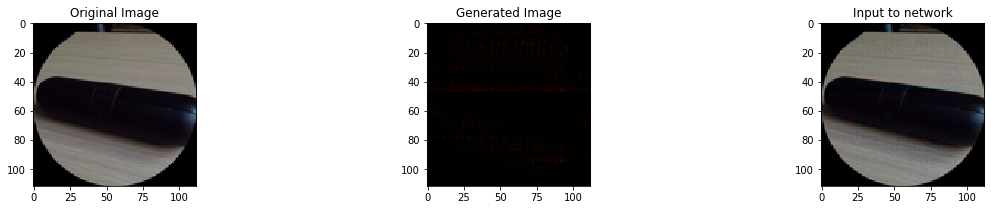

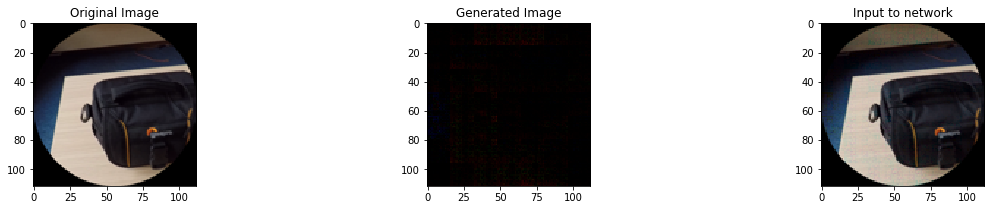

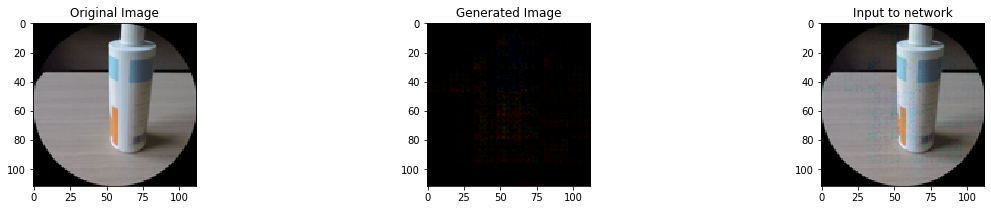

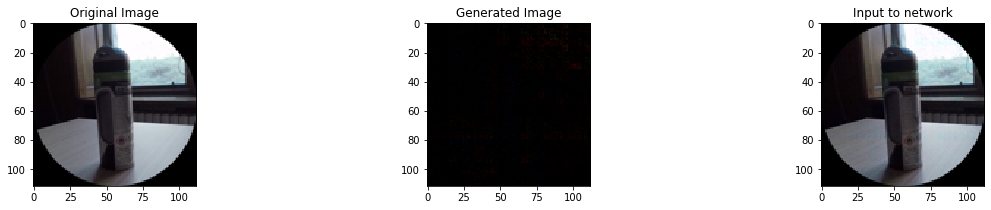

...

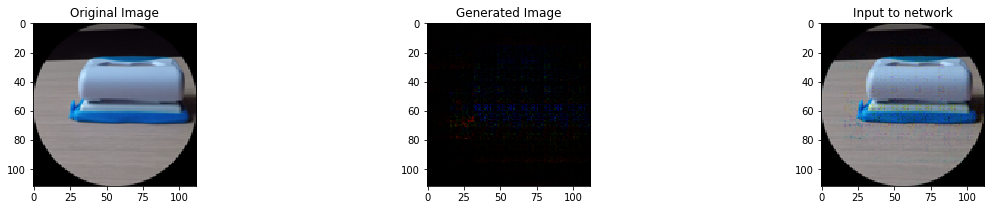

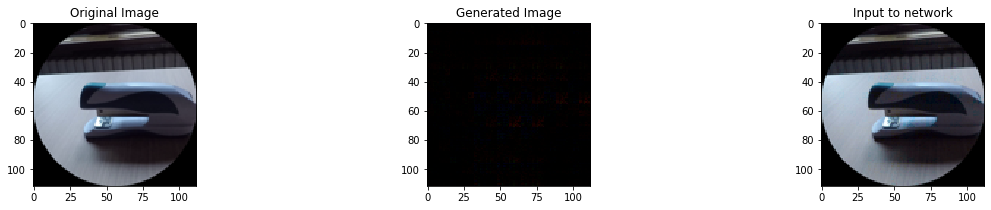

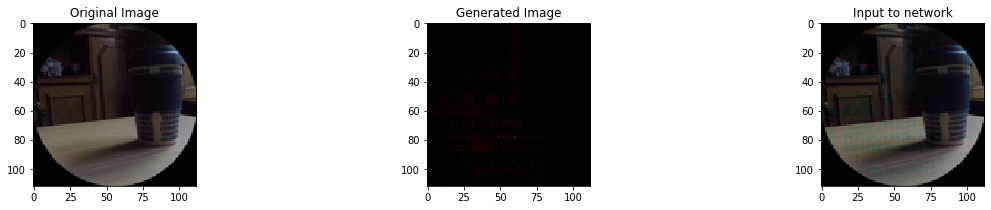

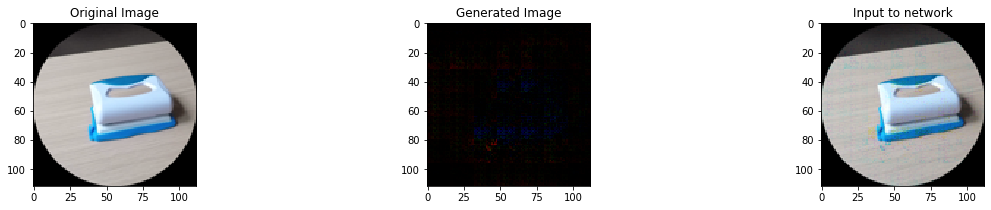

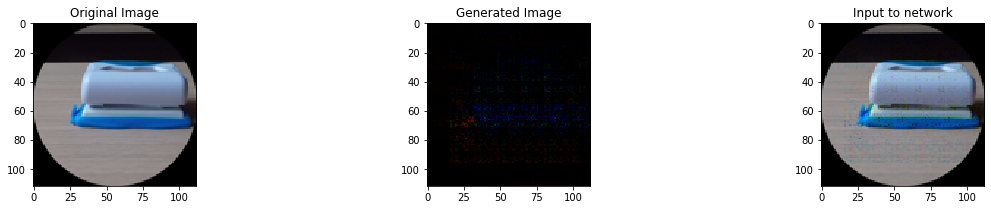

In [0]:
show_examples(model4,"subtractive")

# Subtractive feedback using pretrained classifier

In [0]:
model5 = Mixed().to(device)
model5.conv1.weight = model1.conv1.weight
model5.conv2.weight = model1.conv2.weight
model5.conv3.weight = model1.conv3.weight
model5.conv4.weight = model1.conv4.weight
model5.fc1.weight = model1.fc1.weight
model5.fc2.weight = model1.fc2.weight
model5.conv1.weight.requires_grad = False
model5.conv2.weight.requires_grad = False
model5.conv3.weight.requires_grad = False
model5.conv4.weight.requires_grad = False
model5.fc1.weight.requires_grad = False
model5.fc1.bias.requires_grad = False
model5.fc2.weight.requires_grad = False
model5.fc2.bias.requires_grad = False
optimizer = optim.Adam(filter(lambda p: p.requires_grad, model5.parameters()), lr=0.001)
criterion = nn.CrossEntropyLoss()
model5,model5_stats = train_validate(model5,optimizer,criterion,"subtractive")

Epoch 0


RuntimeError: ignored

In [0]:
name = "alvaro_model5_mixed_subtr_pre.pth"
path = F"/content/drive/My Drive/Colab Notebooks/Alvaro/{name}"
torch.save(model5.state_dict(), path)

/content/drive/My Drive/Colab Notebooks/Alvaro/alvaro_model5_mixed_subtr_pre.pthLoss model5.png
/content/drive/My Drive/Colab Notebooks/Alvaro/alvaro_model5_mixed_subtr_pre.pthAccuracy model5.png


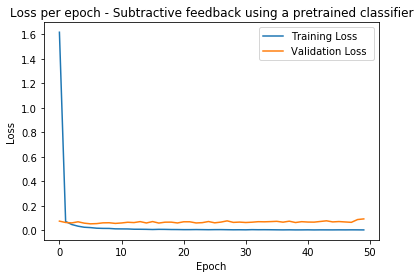

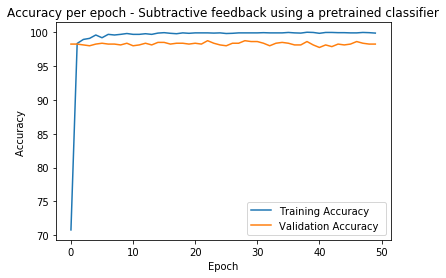

In [0]:
plt.rcParams["figure.figsize"] = (6,4)
plot_graph(model5_stats[0],model5_stats[2],epochs,"Loss ","subtractive pre")
plot_graph(model5_stats[1],model5_stats[3],epochs,"Accuracy ","subtractive pre")

In [0]:
accuracies_model5 = test_model(model5,criterion,"subtractive")


Test loss: 0.2622 
Testing Accuracy: 761/800 (95%)
bag Class Accuracy: 36/40 (90.0%)
beer Class Accuracy: 40/40 (100.0%)
book Class Accuracy: 38/40 (95.0%)
case Class Accuracy: 40/40 (100.0%)
coffee Class Accuracy: 39/40 (97.5%)
cup Class Accuracy: 37/40 (92.5%)
deodorant Class Accuracy: 39/40 (97.5%)
eraser Class Accuracy: 38/40 (95.0%)
hole Class Accuracy: 40/40 (100.0%)
mouse Class Accuracy: 34/40 (85.0%)
mug Class Accuracy: 37/40 (92.5%)
sleep Class Accuracy: 37/40 (92.5%)
speaker Class Accuracy: 35/40 (87.5%)
spray Class Accuracy: 39/40 (97.5%)
stapler Class Accuracy: 38/40 (95.0%)
tape Class Accuracy: 37/40 (92.5%)
tea Class Accuracy: 40/40 (100.0%)
tissues Class Accuracy: 40/40 (100.0%)
umbrella Class Accuracy: 38/40 (95.0%)
watch Class Accuracy: 39/40 (97.5%)
[[36  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  4  0]
 [ 0 40  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0 38  0  0  0  0  0  0  0  0  1  0  1  0  0  0  0  0  0]
 [ 0  0  0 40  0  0  0  0  0  0 

[93.50961538461539, 93.99038461538461, 94.11057692307692, 94.23076923076923, 94.35096153846153, 94.71153846153847, 95.07211538461539, 94.95192307692308, 94.83173076923077, 94.95192307692308]
/content/drive/My Drive/Colab Notebooks/Alvaro/alvaro_model5_mixed_subtr_pre.pthaccperit_model5.png


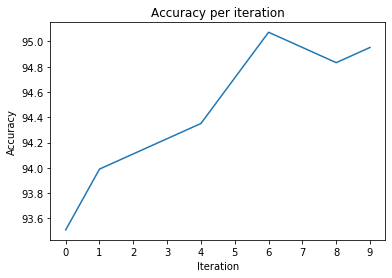

In [0]:
accuracy_per_iteration(accuracies_model5,"subtractive pre")

In [0]:
print("Training losses",model5_stats[0])
print("Training accuracies",model5_stats[1])
print("Val losses",model5_stats[2])
print("Val acc",model5_stats[3])

Training losses [1.6158269116356965, 0.07107508670538663, 0.0460119484337047, 0.03264552243286743, 0.024011185673414728, 0.02113208537118044, 0.016212419905525174, 0.014640818450949151, 0.014267331245180686, 0.010975885777763322, 0.010355345455405769, 0.010008160097400833, 0.007741142549552022, 0.007502122080462871, 0.0068693107175204215, 0.0054841159067291305, 0.006849602500078616, 0.006451189397368581, 0.005407766929529316, 0.005145965026767952, 0.004388228046445874, 0.004475005351660456, 0.005071506743985082, 0.004525445440196563, 0.0038940785860741, 0.0045176923152539525, 0.004665875808350392, 0.003935743103256755, 0.003239425052657679, 0.003519320623532621, 0.0029853288934136796, 0.004384135898031672, 0.0037058649132832213, 0.00394797021967497, 0.003554365993057218, 0.0029464410260484327, 0.0025141339277015497, 0.002991597622803965, 0.0023332610616316747, 0.0024428319184253257, 0.002893020551953668, 0.0021714053587481887, 0.002615261074284717, 0.002466796297097972, 0.0023821985751

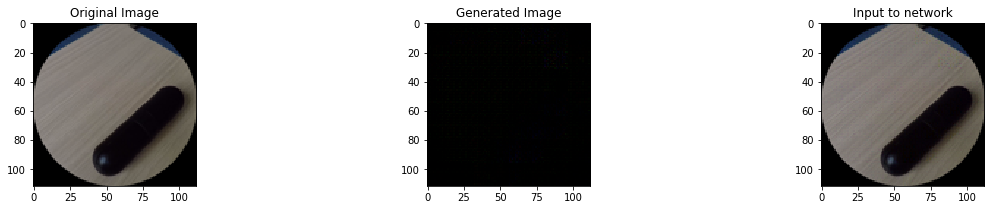

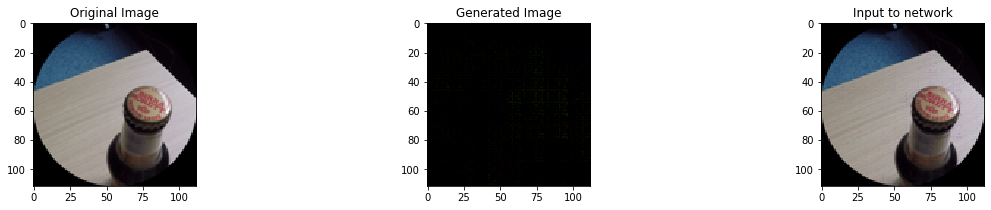

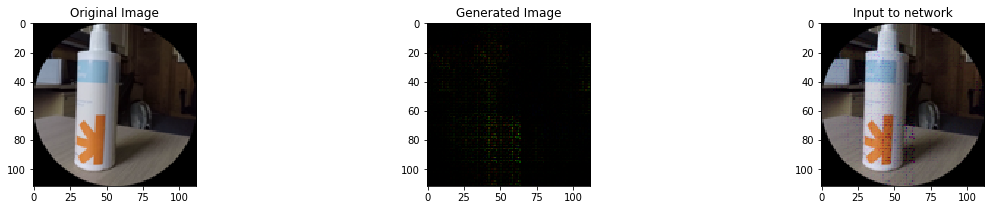

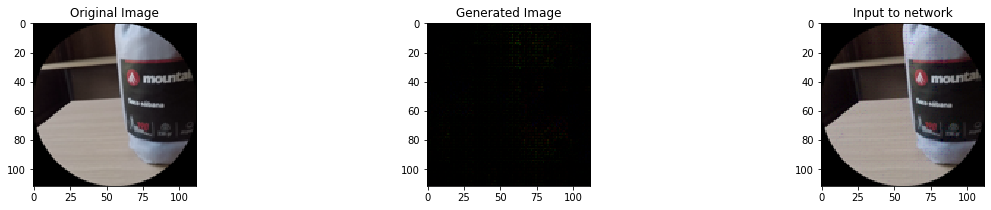

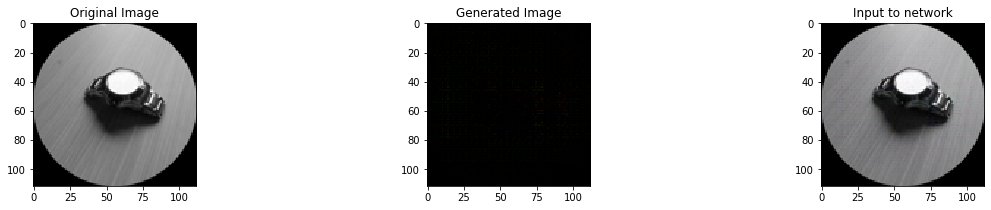

...

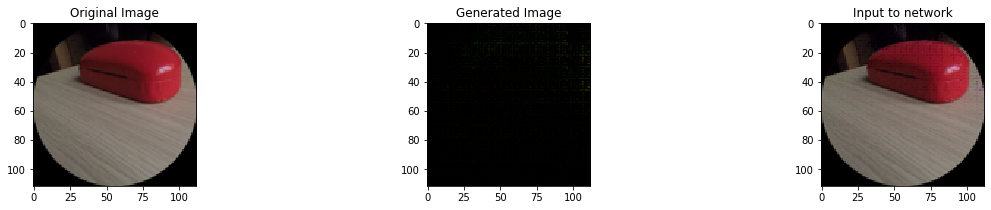

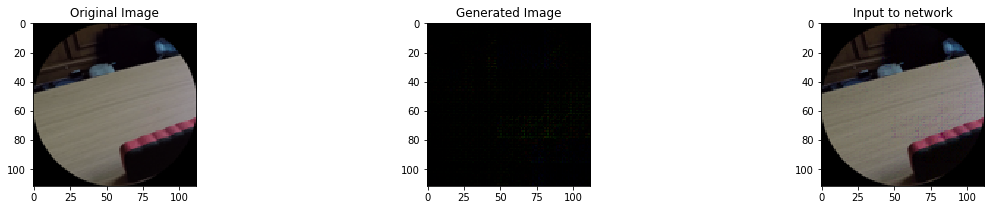

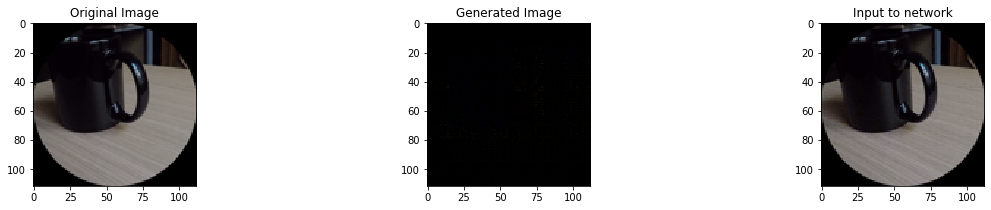

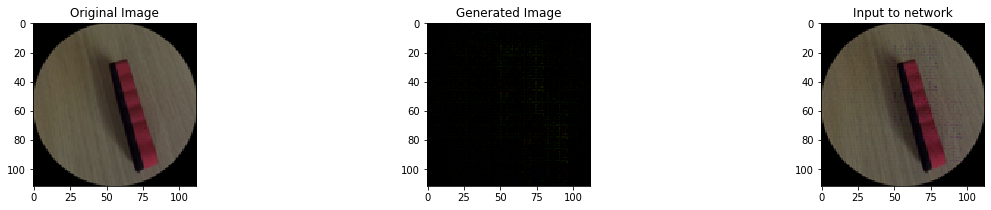

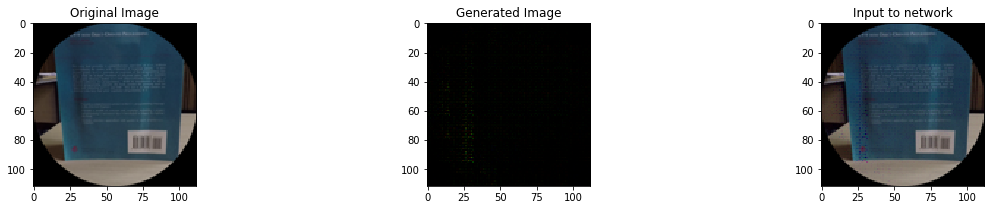

KeyboardInterrupt: ignored

In [0]:
show_examples(model5,"subtractive")

# Unfreezing (currently hidden)

In [0]:
#unfreeze layers

model9.fc1.weight.requires_grad = True
model9.fc1.bias.requires_grad = True
model9.fc2.weight.requires_grad = True
model9.fc2.bias.requires_grad = True
optimizer = optim.Adam(filter(lambda p: p.requires_grad, model9.parameters()), lr=0.001)
#optimizer.add_param_group({'params': model9.fc1.parameters()})
#optimizer.add_param_group({'params': model9.fc2.parameters()})
#optimizer = optim.Adam(filter(lambda p: p.requires_grad, model9.parameters()), lr=0.001)
training_losses = []
train_accuracies = []
val_losses = []
val_accuracies = []
criterion1 = nn.MSELoss()
criterion2 = nn.CrossEntropyLoss()
for epoch in range(epochs):
    print("Epoch", epoch)
    #train
    model9.train()
    train_epoch_loss = 0
    train_correct = 0
    for i,(images,labels) in enumerate(trainloader):
        images, labels = images.cuda(),labels.cuda()
        optimizer.zero_grad()
        generated,predicted = model9(images) #first pass
        alpha = 0.1
        for i in range(n_iterations):
          generated,predicted = model9(images-generated*alpha)
          alpha = alpha + 0.1
          loss1 = criterion1(generated,images)
          loss2 = criterion2(predicted,labels)
          loss = loss2
          loss.backward(retain_graph=True)
        train_epoch_loss += loss.item()
        optimizer.step()
        pred = predicted.max(1, keepdim=True)[1] # get the index of the max log-probability
        train_correct += pred.eq(labels.view_as(pred)).sum().item()
        #if index % 10 == 0:
            #print('Train Epoch: {} [{}/{} ({:.0f}%)]\tLoss: {:.6f}'.format(
                #epoch, index * len(images), len(trainloader.dataset),
                #100. * index / len(trainloader), loss.item()))
    train_epoch_loss /= len(trainloader)
    print('Average training loss: {:.4f}, Training Accuracy: {}/{} ({:.0f}%)'.format(
        train_epoch_loss, train_correct, len(trainloader.dataset),
        100. * train_correct / len(trainloader.dataset)))
    training_losses.append(train_epoch_loss)
    train_accuracies.append(100. * train_correct / len(trainloader.dataset))

    #validate
    model9.eval()
    val_epoch_loss = 0
    val_correct = 0
    with torch.no_grad():
        for images, labels in valloader:
            images, labels = images.cuda(),labels.cuda()
            generated,predicted = model9(images) #first pass
            alpha = 0.1
            for i in range(n_iterations):
                generated,predicted= model9(images-generated*alpha)
                alpha = alpha + 0.1
                loss1 = criterion1(generated,images)
                loss2 = criterion2(predicted,labels)
                loss = loss2
            val_epoch_loss += loss.item()
            pred = predicted.max(1, keepdim=True)[1] # get the index of the max log-probability
            val_correct += pred.eq(labels.view_as(pred)).sum().item()
    val_epoch_loss /= len(valloader)
    print('Average validation loss: {:.4f}, Validation Accuracy: {}/{} ({:.0f}%)'.format(
        val_epoch_loss, val_correct, len(valloader.dataset),
        100. * val_correct / len(valloader.dataset)))
    val_losses.append(val_epoch_loss)
    val_accuracies.append(100. * val_correct / len(valloader.dataset))

name = "alvaro_unfrozen.pth"
path = F"/content/drive/My Drive/Colab Notebooks/Alvaro/{name}"
torch.save(model9.state_dict(), path)

In [0]:
model9.eval()
test_epoch_loss = 0
test_correct = 0

with torch.no_grad():
      accuracies = [[] for i in range(n_iterations)]
      for images, labels in testloader:
            images, labels = images.cuda(),labels.cuda()
            generated,predicted = model9(images) #first pass
            alpha = 0.1
            for i in range(n_iterations):
                iteration_correct = 0
                generated,predicted = model9(images-generated*alpha)
                alpha = alpha + 0.1
                loss1 = criterion1(generated,images)
                loss2 = criterion2(predicted,labels)
                loss = loss2

                pred_it = predicted.max(1, keepdim=True)[1]
                iteration_correct += pred_it.eq(labels.view_as(pred_it)).sum().item()
                accuracies[i] = accuracies[i] + [100.*iteration_correct/len(images)]

            test_epoch_loss += loss.item()
            pred = predicted.max(1, keepdim=True)[1] # get the index of the max log-probability
            test_correct += pred.eq(labels.view_as(pred)).sum().item()
test_epoch_loss /= len(testloader)
print('Average testing loss: {:.4f}\nTesting Accuracy: {}/{} ({:.0f}%)'.format(
        test_epoch_loss, test_correct, len(testloader.dataset),
        100. * test_correct / len(testloader.dataset)))
print("Lowest validation loss", min(val_losses))
print("Lowest training loss", min(training_losses))
print("Highest training accuracy",max(train_accuracies))
print("Highest validation accuracy",max(val_accuracies))

In [0]:
plt.rcParams["figure.figsize"] = (6,4)
plot_graph(training_losses,val_losses,epochs,"Loss ")
plot_graph(train_accuracies,val_accuracies,epochs,"Accuracy ")

In [0]:
for i, el in enumerate(accuracies):
  accuracies[i] = sum(el)/len(testloader)
print(accuracies)
plt.figure()
plt.plot(range(n_iterations),accuracies)
plt.title("Accuracy per iteration")
plt.xticks(range(n_iterations))
plt.xlabel("Iteration")
plt.ylabel("Accuracy")

In [0]:
plt.rcParams["figure.figsize"] = (20,3)
test_images, labels = next(iter(testloader))
test_images = test_images.cuda()
generated, test_output = model9(test_images)
alpha = 0.1
for i in range(n_iterations):
  generated,test_output = model9(test_images-generated*alpha)
  alpha = alpha + 0.1

for i in range(len(images)):
    fig = plt.figure()
    plot = fig.add_subplot(1, 3, 1)
    plot.set_title('Original Image')
    image_input = np.transpose(test_images[i].cpu(),(1,2,0))
    image_output = np.transpose(generated[i].cpu().detach(),(1,2,0))
    imgplot = plt.imshow(image_input)
    plot = fig.add_subplot(1, 3, 2)
    plot.set_title('Generated Image')
    plt.imshow(np.clip(image_output,0,1))
    plot = fig.add_subplot(1,3,3)
    difference = np.transpose(test_images[i].cpu(),(1,2,0)) - np.transpose(generated[i].cpu().detach(),(1,2,0))
    plot.set_title("Input to network")
    plt.imshow(np.clip(difference,0,1))
    #plt.imshow(image_input)
    plt.show()

In [0]:
for i in range(len(test_images)):
  original = transforms.ToPILImage()(test_images[i].cpu())
  generated_image = transforms.ToPILImage()(generated[i].cpu())
  display(original)
  display(generated_image)

# Multiplication

In [0]:
model6 = Mixed().to(device)
optimizer = optim.Adam(model6.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss()
model6,model6_stats = train_validate(model6,optimizer,criterion,"multiplicative")

Epoch 0
Average training loss: 2.8055, Training Accuracy: 329/3200 (10%)
Average validation loss: 3.0217, Validation Accuracy: 24/800 (3%)
Epoch 1
Average training loss: 2.4969, Training Accuracy: 633/3200 (20%)
Average validation loss: 8.6882, Validation Accuracy: 43/800 (5%)
Epoch 2
Average training loss: 2.0277, Training Accuracy: 1113/3200 (35%)
Average validation loss: 3.6009, Validation Accuracy: 223/800 (28%)
Epoch 3
Average training loss: 1.1782, Training Accuracy: 1983/3200 (62%)
Average validation loss: 2.5798, Validation Accuracy: 506/800 (63%)
Epoch 4
Average training loss: 0.6537, Training Accuracy: 2518/3200 (79%)
Average validation loss: 2.1540, Validation Accuracy: 598/800 (75%)
Epoch 5
Average training loss: 0.3579, Training Accuracy: 2818/3200 (88%)
Average validation loss: 2.1607, Validation Accuracy: 702/800 (88%)
Epoch 6
Average training loss: 0.2051, Training Accuracy: 2977/3200 (93%)
Average validation loss: 2.7275, Validation Accuracy: 697/800 (87%)
Epoch 7
Aver

In [0]:
name = "alvaro_model6_mixed_mult.pth"
path = F"/content/drive/My Drive/Colab Notebooks/Alvaro/{name}"
torch.save(model6.state_dict(), path)

/content/drive/My Drive/Colab Notebooks/Alvaro/alvaro_model6_mixed_mult.pthLoss model6.png
/content/drive/My Drive/Colab Notebooks/Alvaro/alvaro_model6_mixed_mult.pthAccuracy model6.png


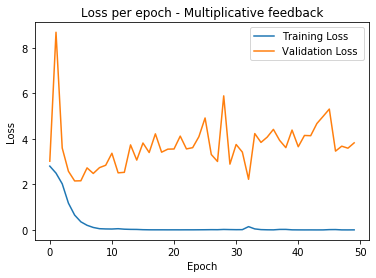

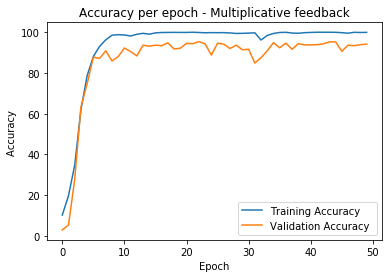

In [0]:
plt.rcParams["figure.figsize"] = (6,4)
plot_graph(model6_stats[0],model6_stats[2],epochs,"Loss ","multiplicative")
plot_graph(model6_stats[1],model6_stats[3],epochs,"Accuracy ","multiplicative")

In [0]:
accuracies_model6 = test_model(model6,criterion,"multiplicative")


Test loss: 4.3791 
Testing Accuracy: 652/800 (82%)
bag Class Accuracy: 35/40 (87.5%)
beer Class Accuracy: 40/40 (100.0%)
book Class Accuracy: 38/40 (95.0%)
case Class Accuracy: 38/40 (95.0%)
coffee Class Accuracy: 31/40 (77.5%)
cup Class Accuracy: 34/40 (85.0%)
deodorant Class Accuracy: 25/40 (62.5%)
eraser Class Accuracy: 29/40 (72.5%)
hole Class Accuracy: 40/40 (100.0%)
mouse Class Accuracy: 25/40 (62.5%)
mug Class Accuracy: 26/40 (65.0%)
sleep Class Accuracy: 27/40 (67.5%)
speaker Class Accuracy: 28/40 (70.0%)
spray Class Accuracy: 29/40 (72.5%)
stapler Class Accuracy: 34/40 (85.0%)
tape Class Accuracy: 33/40 (82.5%)
tea Class Accuracy: 39/40 (97.5%)
tissues Class Accuracy: 37/40 (92.5%)
umbrella Class Accuracy: 31/40 (77.5%)
watch Class Accuracy: 33/40 (82.5%)
[[35  0  0  0  0  2  0  0  0  0  0  0  0  0  0  0  1  0  2  0]
 [ 0 40  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0 38  0  0  0  0  0  0  0  0  0  0  2  0  0  0  0  0  0]
 [ 0  0  0 38  1  0  0  0  0  0  0 

[4.206730769230769, 12.01923076923077, 26.322115384615383, 47.23557692307692, 64.1826923076923, 76.92307692307692, 84.01442307692308, 87.6201923076923, 86.89903846153847, 81.85096153846153]
/content/drive/My Drive/Colab Notebooks/Alvaro/alvaro_model6_mixed_mult.pthaccperit_model6.png


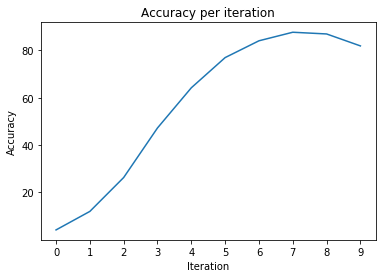

In [0]:
accuracy_per_iteration(accuracies_model6,"multiplicative")

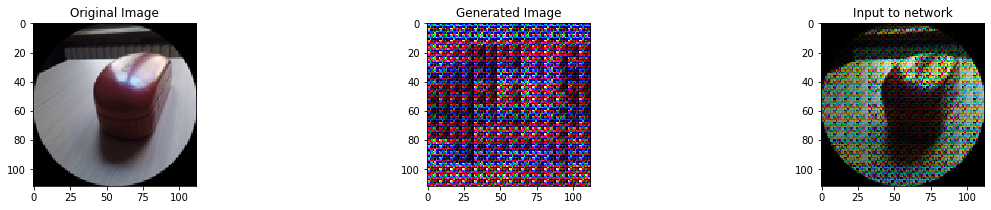

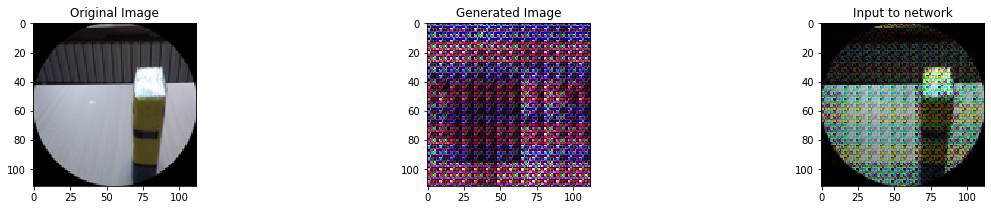

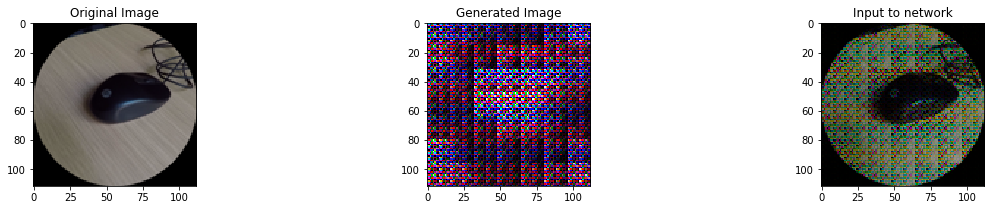

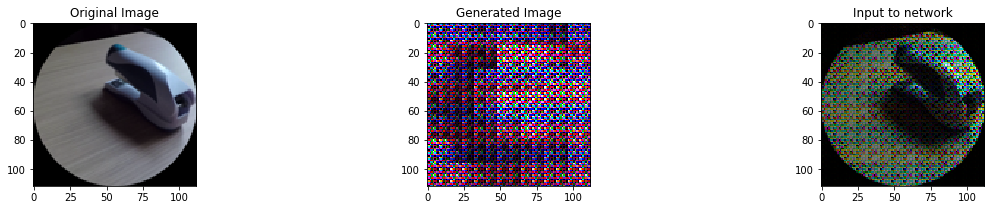

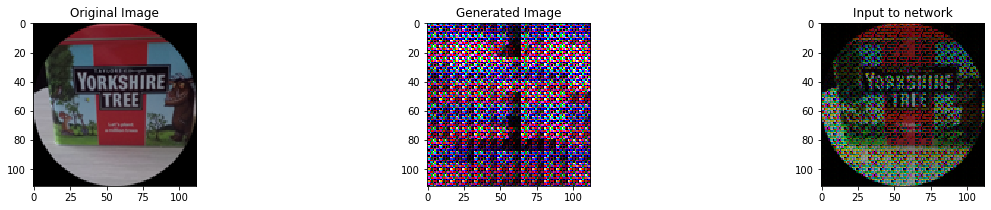

...

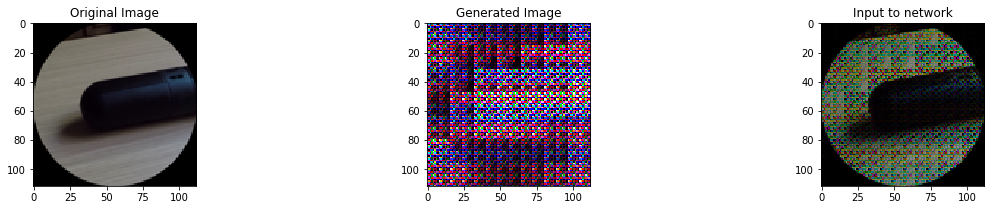

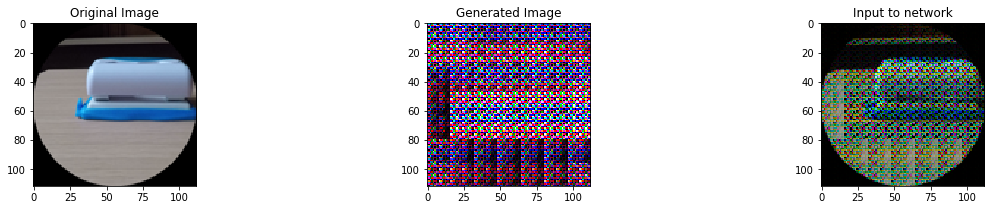

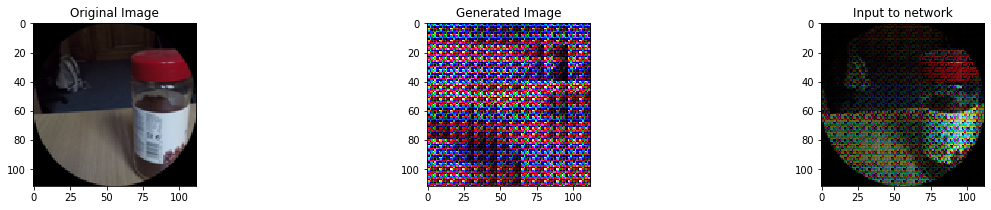

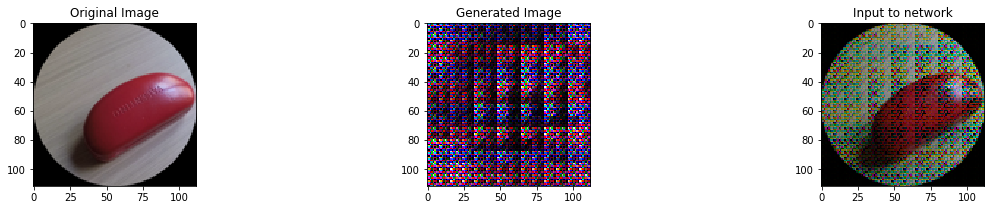

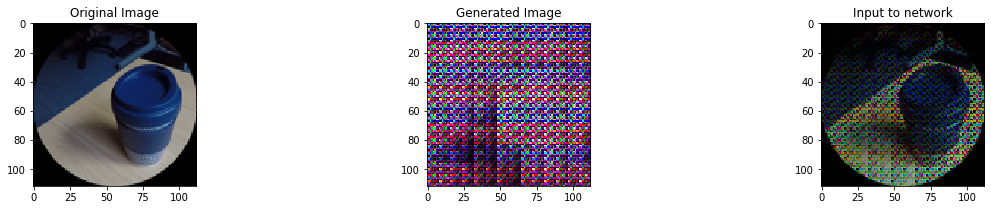

In [0]:
show_examples(model6,"multiplicative")

In [0]:
print("Training losses",model6_stats[0])
print("Training accuracies",model6_stats[1])
print("Val losses",model6_stats[2])
print("Val acc",model6_stats[3])

Training losses [2.80551267004013, 2.496856613159179, 2.0277099680900568, 1.178180035829544, 0.653662125825882, 0.3579204452335834, 0.20510693097114566, 0.10974719748832286, 0.05562216115184129, 0.04467877851752565, 0.041077465573325755, 0.055159669321263205, 0.03355250998446717, 0.02548992096603615, 0.02299230848264415, 0.011683532139897576, 0.0069887739007026516, 0.006061339345731538, 0.006362243928677346, 0.005417578183769367, 0.005974781031633029, 0.005414189481987708, 0.006363322761182644, 0.0060279958147093585, 0.007655542197158867, 0.009767586022120668, 0.013019606201327406, 0.011352185740244748, 0.022372474419797082, 0.016617821512329097, 0.012492555950408128, 0.01397787726374736, 0.14616578224487603, 0.04628660108899929, 0.015029173985734813, 0.0072926466508015445, 0.004600728302641074, 0.02374358988754466, 0.024250780585083703, 0.005767462577627156, 0.0034341002519404362, 0.0023943915117606586, 0.0027808093174376152, 0.0018868057411664263, 0.0024407273750066444, 0.01482465080

# Multiplication with pretrained classifier

In [0]:
model1 = Classifier().cuda()
name = "alvaro_model1_classier_plain.pth"
path = F"/content/drive/My Drive/Colab Notebooks/Alvaro/{name}"
model1.load_state_dict(torch.load(path))

<All keys matched successfully>

In [0]:
model7 = Mixed().to(device)
model7.conv1.weight = model1.conv1.weight
model7.conv2.weight = model1.conv2.weight
model7.conv3.weight = model1.conv3.weight
model7.conv4.weight = model1.conv4.weight
model7.fc1.weight = model1.fc1.weight
model7.fc2.weight = model1.fc2.weight
model7.conv1.weight.requires_grad = False
model7.conv2.weight.requires_grad = False
model7.conv3.weight.requires_grad = False
model7.conv4.weight.requires_grad = False
model7.fc1.weight.requires_grad = False
model7.fc1.bias.requires_grad = False
model7.fc2.weight.requires_grad = False
model7.fc2.bias.requires_grad = False
optimizer = optim.Adam(filter(lambda p: p.requires_grad, model7.parameters()), lr=0.001)
criterion = nn.CrossEntropyLoss()
model7, model7_stats = train_validate(model7,optimizer,criterion,"multiplicative")

RuntimeError: ignored

In [0]:
name = "alvaro_model7_mixed_mult_pre.pth"
path = F"/content/drive/My Drive/Colab Notebooks/Alvaro/{name}"
torch.save(model7.state_dict(), path)

In [0]:
plt.rcParams["figure.figsize"] = (6,4)
plot_graph(model7_stats[0],model7_stats[2],epochs,"Loss ","multiplicative pre")
plot_graph(model7_stats[1],model7_stats[3],epochs,"Accuracy ","multiplicative pre")

In [0]:
accuracies_model7 = test_model(model7,criterion,"multiplicative")


Test loss: 4.6785 
Testing Accuracy: 506/800 (63%)
bag Class Accuracy: 20/40 (50.0%)
beer Class Accuracy: 6/40 (15.0%)
book Class Accuracy: 28/40 (70.0%)
case Class Accuracy: 26/40 (65.0%)
coffee Class Accuracy: 28/40 (70.0%)
cup Class Accuracy: 27/40 (67.5%)
deodorant Class Accuracy: 35/40 (87.5%)
eraser Class Accuracy: 28/40 (70.0%)
hole Class Accuracy: 37/40 (92.5%)
mouse Class Accuracy: 13/40 (32.5%)
mug Class Accuracy: 19/40 (47.5%)
sleep Class Accuracy: 35/40 (87.5%)
speaker Class Accuracy: 12/40 (30.0%)
spray Class Accuracy: 11/40 (27.5%)
stapler Class Accuracy: 28/40 (70.0%)
tape Class Accuracy: 32/40 (80.0%)
tea Class Accuracy: 38/40 (95.0%)
tissues Class Accuracy: 37/40 (92.5%)
umbrella Class Accuracy: 9/40 (22.5%)
watch Class Accuracy: 37/40 (92.5%)
[[20  0  1  0  0  0  0  0  0  1  1 14  0  0  0  0  3  0  0  0]
 [ 0  6  0  0  0  0  7  0  0  0  0  7  0  0  0  2 12  6  0  0]
 [ 0  0 28  0  0  0  1  0  1  0  0  6  0  0  0  1  2  1  0  0]
 [ 0  0  0 26  0  0  0  9  0  0  0  0  

[7.331730769230769, 7.451923076923077, 25.240384615384617, 37.74038461538461, 46.39423076923077, 52.52403846153846, 56.49038461538461, 60.09615384615385, 62.25961538461539, 63.34134615384615]
/content/drive/My Drive/Colab Notebooks/Alvaro/alvaro_model7_mixed_mult_pre.pthaccperit_model7.png


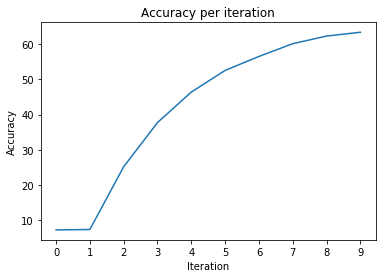

In [0]:
accuracy_per_iteration(accuracies_model7,"multiplicative pre")

In [0]:
print("Training losses",model7_stats[0])
print("Training accuracies",model7_stats[1])
print("Val losses",model7_stats[2])
print("Val acc",model7_stats[3])

NameError: ignored

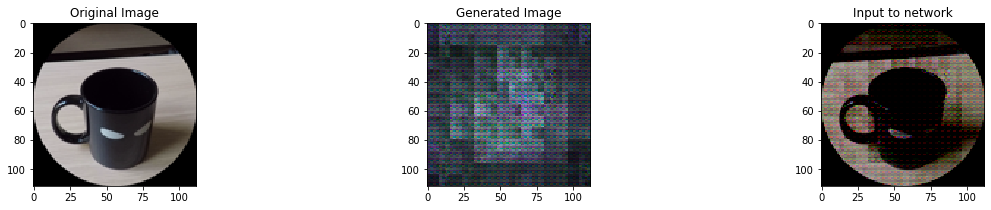

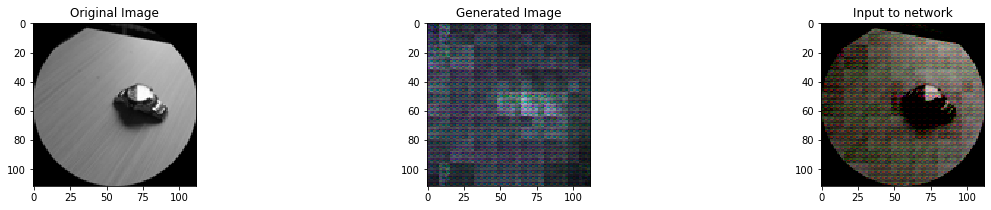

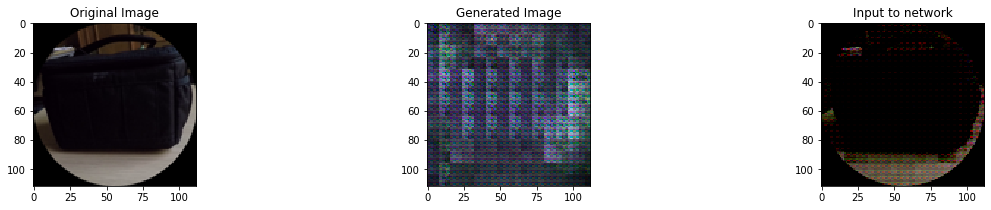

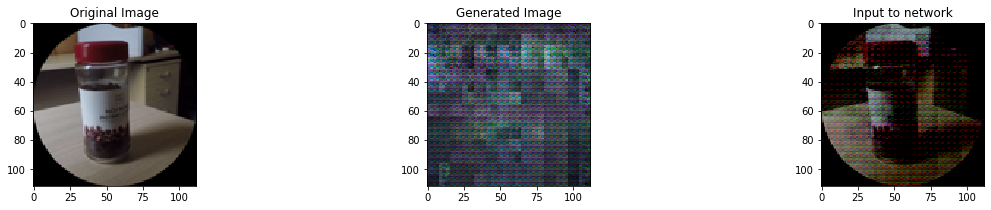

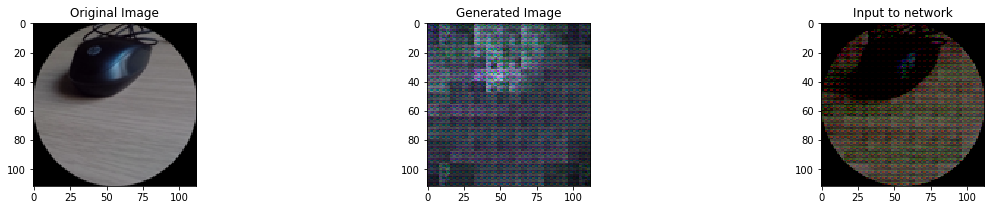

...

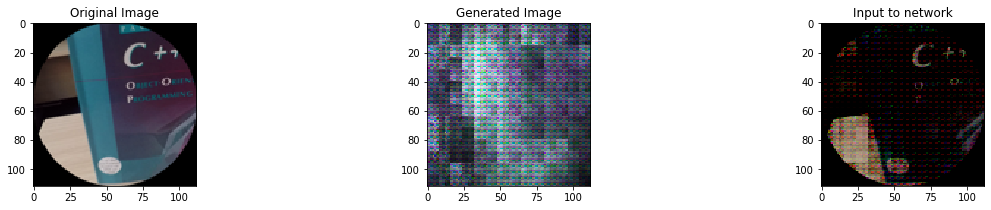

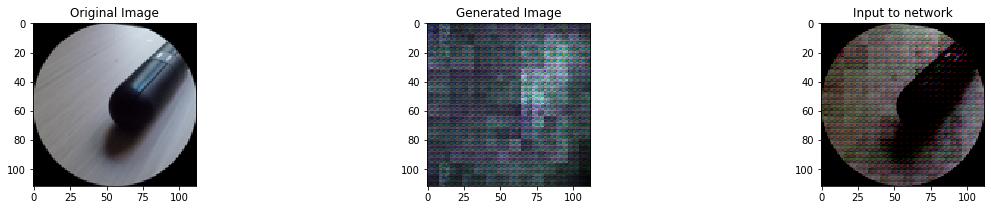

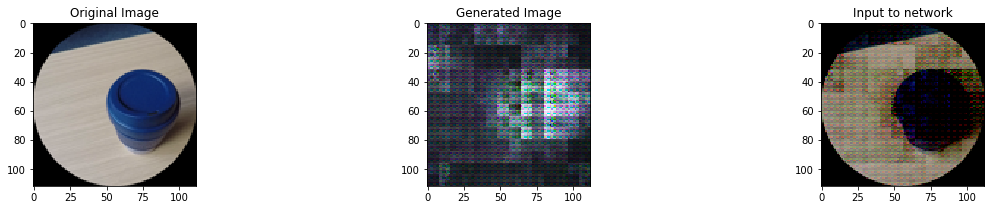

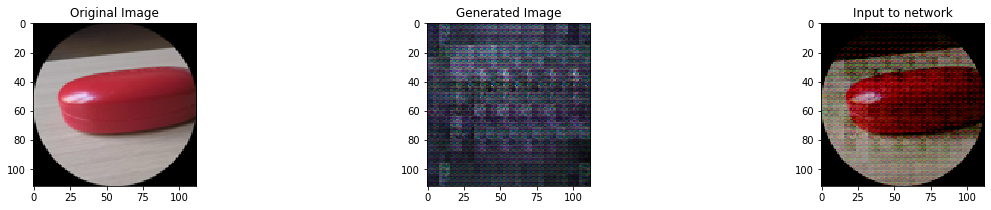

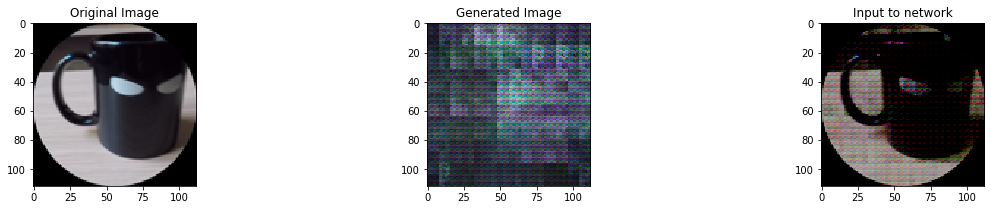

In [0]:
show_examples(model7,"multiplicative")

# Using output as second input channel

In [0]:
class GenOutClassifier(nn.Module):
    def __init__(self):
        super(GenOutClassifier, self).__init__()
        self.conv1 = nn.Conv2d(6, 32, 3, 1, 1, bias=False)
        self.conv1_bn = nn.BatchNorm2d(32)
        self.conv2 = nn.Conv2d(32, 64, 3, 1, 1, bias=False)
        self.conv2_bn = nn.BatchNorm2d(64)
        self.conv3 = nn.Conv2d(64, 128, 3, 1, 1, bias=False)
        self.conv4 = nn.Conv2d(128,256,3,1,1,bias=False)
        self.fc1 = nn.Linear(12544, 500)
        self.fc1_drop = nn.Dropout2d(p=0.5)
        self.fc2 = nn.Linear(500,256)
        self.fc2_drop = nn.Dropout2d(p=0.4)
        self.fc3 = nn.Linear(256,20)
        self.pool = nn.MaxPool2d(2)

    def forward(self, x):
        x = F.leaky_relu(self.pool(self.conv1_bn(self.conv1(x))))
        x = F.leaky_relu(self.pool(self.conv2_bn(self.conv2(x))))
        x = F.leaky_relu(self.pool(self.conv3(x)))
        x = F.leaky_relu(self.pool(self.conv4(x)))
        x = x.view(x.size(0),-1)
        x = F.leaky_relu(self.fc1_drop(self.fc1(x)))
        x = F.leaky_relu(self.fc2_drop(self.fc2(x)))
        x = self.fc3(x)
        return F.log_softmax(x, dim=1)

In [0]:
model8 = GenOutClassifier().cuda()
optimizer = optim.Adam(model8.parameters(),lr=0.001)
criterion = nn.CrossEntropyLoss()
model8, model8_stats = train_validate(model8,optimizer,criterion,"plain genout")

Epoch 0
Average training loss: 2.6793, Training Accuracy: 444/3200 (14%)
Average validation loss: 2.1974, Validation Accuracy: 192/800 (24%)
Epoch 1
Average training loss: 1.6758, Training Accuracy: 1433/3200 (45%)
Average validation loss: 2.0912, Validation Accuracy: 300/800 (38%)
Epoch 2
Average training loss: 1.0619, Training Accuracy: 2071/3200 (65%)
Average validation loss: 0.8332, Validation Accuracy: 581/800 (73%)
Epoch 3
Average training loss: 0.6802, Training Accuracy: 2515/3200 (79%)
Average validation loss: 0.4571, Validation Accuracy: 684/800 (86%)
Epoch 4
Average training loss: 0.3970, Training Accuracy: 2810/3200 (88%)
Average validation loss: 0.2715, Validation Accuracy: 733/800 (92%)
Epoch 5
Average training loss: 0.3008, Training Accuracy: 2878/3200 (90%)
Average validation loss: 0.2306, Validation Accuracy: 745/800 (93%)
Epoch 6
Average training loss: 0.2210, Training Accuracy: 2963/3200 (93%)
Average validation loss: 0.2663, Validation Accuracy: 736/800 (92%)
Epoch 7

In [0]:
test_model(model8,criterion,"plain genout")


Test loss: 0.3419 
Testing Accuracy: 740/800 (92%)
bag Class Accuracy: 35/40 (87.5%)
beer Class Accuracy: 38/40 (95.0%)
book Class Accuracy: 39/40 (97.5%)
case Class Accuracy: 39/40 (97.5%)
coffee Class Accuracy: 39/40 (97.5%)
cup Class Accuracy: 36/40 (90.0%)
deodorant Class Accuracy: 40/40 (100.0%)
eraser Class Accuracy: 36/40 (90.0%)
hole Class Accuracy: 38/40 (95.0%)
mouse Class Accuracy: 36/40 (90.0%)
mug Class Accuracy: 33/40 (82.5%)
sleep Class Accuracy: 34/40 (85.0%)
speaker Class Accuracy: 32/40 (80.0%)
spray Class Accuracy: 38/40 (95.0%)
stapler Class Accuracy: 35/40 (87.5%)
tape Class Accuracy: 35/40 (87.5%)
tea Class Accuracy: 40/40 (100.0%)
tissues Class Accuracy: 40/40 (100.0%)
umbrella Class Accuracy: 39/40 (97.5%)
watch Class Accuracy: 38/40 (95.0%)
[[35  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  5  0]
 [ 0 38  0  0  0  0  1  0  0  0  0  0  0  0  0  0  1  0  0  0]
 [ 0  0 39  0  0  0  0  0  0  0  0  1  0  0  0  0  0  0  0  0]
 [ 0  0  0 39  0  0  0  1  0  0  0

[[], [], [], [], [], [], [], [], [], []]

/content/drive/My Drive/Colab Notebooks/Alvaro/alvaro_model6_mixed_mult.pthLoss model8.png
/content/drive/My Drive/Colab Notebooks/Alvaro/alvaro_model6_mixed_mult.pthAccuracy model8.png


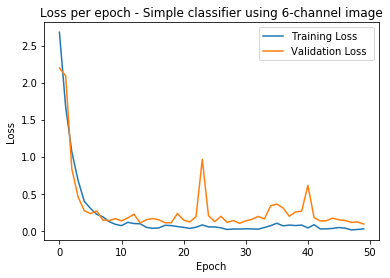

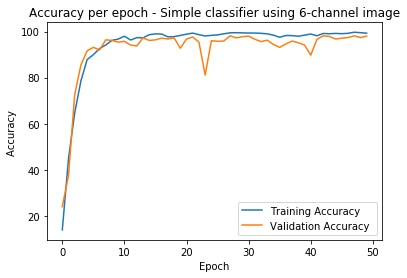

In [0]:
plt.rcParams["figure.figsize"] = (6,4)
plot_graph(model8_stats[0],model8_stats[2],epochs,"Loss ","plain genout")
plot_graph(model8_stats[1],model8_stats[3],epochs,"Accuracy ","plain genout")

In [0]:
name = "alvaro_model8_classifier_genout.pth"
path = F"/content/drive/My Drive/Colab Notebooks/Alvaro/{name}"
torch.save(model8.state_dict(), path)

In [0]:
print("Training losses",model8_stats[0])
print("Training accuracies",model8_stats[1])
print("Val losses",model8_stats[2])
print("Val acc",model8_stats[3])

In [0]:
class Mixed2(nn.Module):
    def __init__(self):
        super(Mixed2, self).__init__()

        self.conv1 = nn.Conv2d(6, 32, 3, 1, 1, bias=False)
        self.conv1_bn = nn.BatchNorm2d(32)
        self.conv2 = nn.Conv2d(32, 64, 3, 1, 1, bias=False)
        self.conv2_bn = nn.BatchNorm2d(64)
        self.conv3 = nn.Conv2d(64, 128, 3, 1, 1, bias=False)
        self.conv4 = nn.Conv2d(128,256,3,1,1,bias=False)
        self.deconv1 = nn.ConvTranspose2d(256,128,2,2,0,bias=False)
        self.deconv2 = nn.ConvTranspose2d (128, 64, 2, 2, 0, bias=False)
        self.deconv3 = nn.ConvTranspose2d (64, 32, 2, 2, 0, bias=False)
        self.deconv4 = nn.ConvTranspose2d (32, 3, 2, 2, 0, bias=False)
        self.fc1 = nn.Linear(12544, 500)
        self.fc1_drop = nn.Dropout2d(p=0.5)
        self.fc2 = nn.Linear(500,256)
        self.fc2_drop = nn.Dropout2d(p=0.4)
        self.fc3 = nn.Linear(256,20)
        self.pool = nn.MaxPool2d(2)

    def forward(self,x):
        x = F.leaky_relu(self.pool(self.conv1_bn(self.conv1(x))))
        x = F.leaky_relu(self.pool(self.conv2_bn(self.conv2(x))))
        x = F.leaky_relu(self.pool(self.conv3(x)))
        encoded = F.leaky_relu(self.pool(self.conv4(x)))
        decoded = F.leaky_relu(self.deconv1(encoded))
        decoded = F.leaky_relu(self.deconv2(decoded))
        decoded = F.leaky_relu(self.deconv3(decoded))
        decoded = F.leaky_relu(self.deconv4(decoded))
        flattened = encoded.view(encoded.size(0),-1)
        predicted = F.leaky_relu(self.fc1_drop(self.fc1(flattened)))
        predicted = F.leaky_relu(self.fc2_drop(self.fc2(predicted)))
        predicted = self.fc3(predicted)
        return torch.tanh(decoded), F.log_softmax(predicted, dim=1)

# Using generator output as second channel from scratch

Epoch 0
Average training loss: 2.3891, Training Accuracy: 819/3200 (26%)
Average validation loss: 1.2515, Validation Accuracy: 457/800 (57%)
Epoch 1
Average training loss: 1.0483, Training Accuracy: 2099/3200 (66%)
Average validation loss: 0.7070, Validation Accuracy: 602/800 (75%)
Epoch 2
Average training loss: 0.5600, Training Accuracy: 2603/3200 (81%)
Average validation loss: 0.3153, Validation Accuracy: 721/800 (90%)
Epoch 3
Average training loss: 0.3165, Training Accuracy: 2875/3200 (90%)
Average validation loss: 0.2186, Validation Accuracy: 749/800 (94%)
Epoch 4
Average training loss: 0.1400, Training Accuracy: 3051/3200 (95%)
Average validation loss: 0.1847, Validation Accuracy: 757/800 (95%)
Epoch 5
Average training loss: 0.1037, Training Accuracy: 3100/3200 (97%)
Average validation loss: 0.1418, Validation Accuracy: 769/800 (96%)
Epoch 6
Average training loss: 0.0438, Training Accuracy: 3157/3200 (99%)
Average validation loss: 0.1189, Validation Accuracy: 778/800 (97%)
Epoch 7

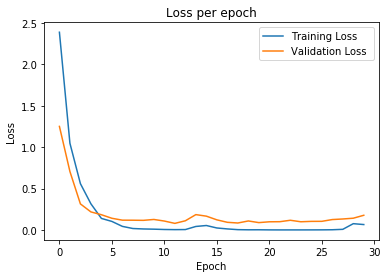

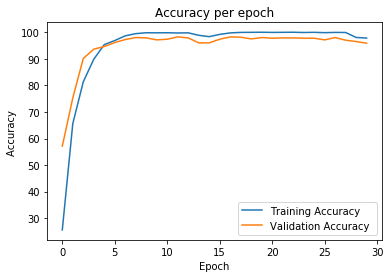

In [0]:
model9 = Mixed2().to(device)
optimizer = optim.Adam(model9.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss()
model9 = train_validate(model9,optimizer,criterion,"genout feedback")

In [0]:
plt.rcParams["figure.figsize"] = (6,4)
plot_graph(model9_stats[0],model9_stats[2],epochs,"Loss ","feedback genout")
plot_graph(model9_stats[1],model9_stats[3],epochs,"Accuracy ","feedback genout")


Test loss: 0.4363 
Testing Accuracy: 713/800 (89%)
bag Class Accuracy: 34/40 (85.0%)
beer Class Accuracy: 37/40 (92.5%)
book Class Accuracy: 39/40 (97.5%)
case Class Accuracy: 39/40 (97.5%)
coffee Class Accuracy: 37/40 (92.5%)
cup Class Accuracy: 35/40 (87.5%)
deodorant Class Accuracy: 36/40 (90.0%)
eraser Class Accuracy: 36/40 (90.0%)
hole Class Accuracy: 38/40 (95.0%)
mouse Class Accuracy: 28/40 (70.0%)
mug Class Accuracy: 36/40 (90.0%)
sleep Class Accuracy: 28/40 (70.0%)
speaker Class Accuracy: 30/40 (75.0%)
spray Class Accuracy: 36/40 (90.0%)
stapler Class Accuracy: 37/40 (92.5%)
tape Class Accuracy: 36/40 (90.0%)
tea Class Accuracy: 38/40 (95.0%)
tissues Class Accuracy: 35/40 (87.5%)
umbrella Class Accuracy: 39/40 (97.5%)
watch Class Accuracy: 39/40 (97.5%)
[[34  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  6  0]
 [ 0 37  0  0  0  0  2  0  0  0  1  0  0  0  0  0  0  0  0  0]
 [ 0  1 39  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0 39  0  0  0  0  0  0  0  0

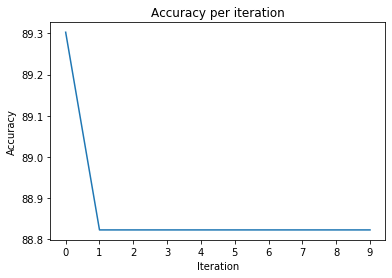

In [0]:
test_model(model9,criterion,"genout feedback")

In [0]:
name = "alvaro_model9_genout_feedback.pth"
path = F"/content/drive/My Drive/Colab Notebooks/Alvaro/{name}"
torch.save(model9.state_dict(), path)

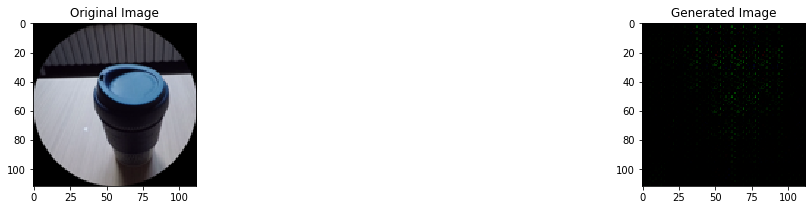

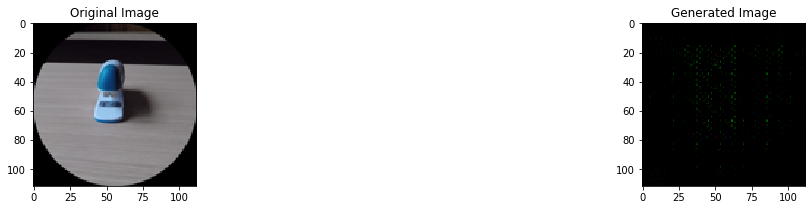

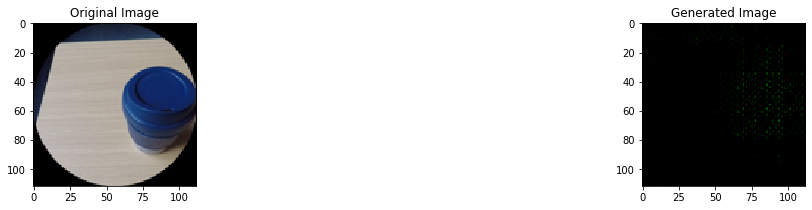

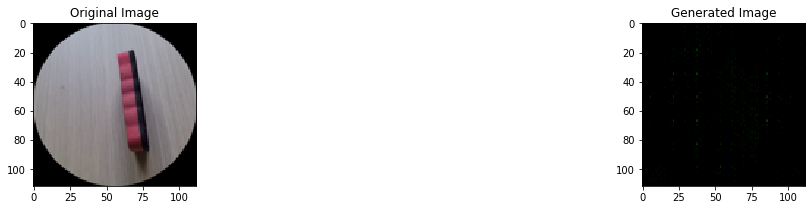

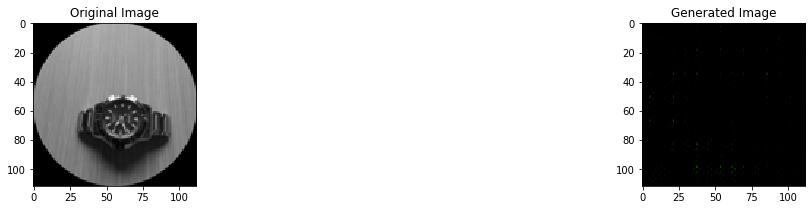

...

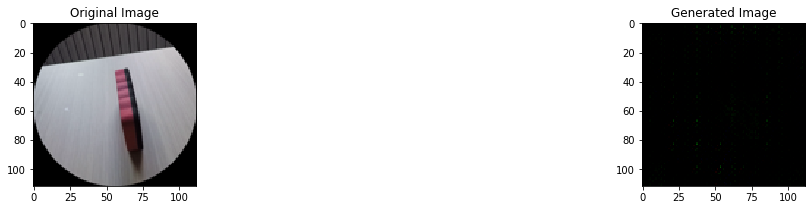

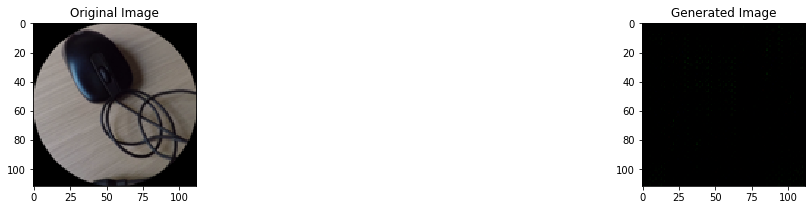

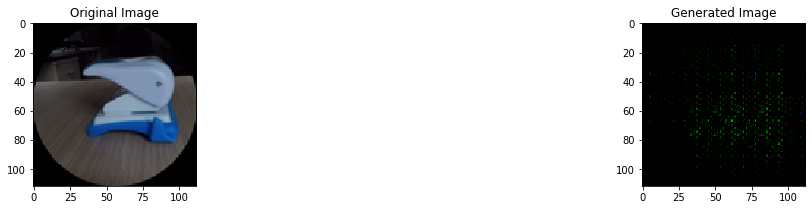

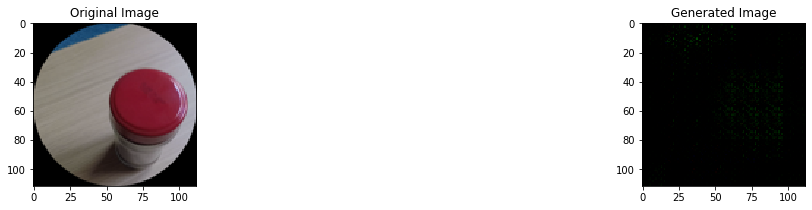

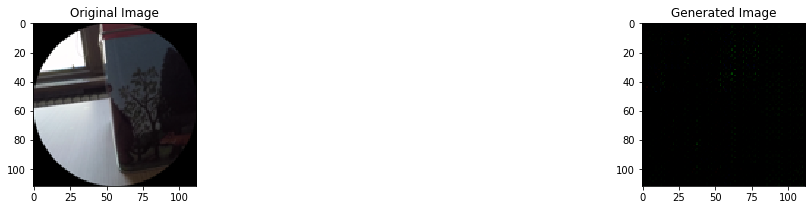

In [0]:
show_examples(model9,"genout feedback")

## Using generator output as second channel pretrained

In [0]:
model8 = GenOutClassifier().cuda()
name = "alvaro_model8_classifier_genout.pth"
path = F"/content/drive/My Drive/Colab Notebooks/Alvaro/{name}"
model8.load_state_dict(torch.load(path))

<All keys matched successfully>

In [0]:
model10 = Mixed2().to(device)
model10.conv1.weight = model8.conv1.weight
model10.conv2.weight = model8.conv2.weight
model10.conv3.weight = model8.conv3.weight
model10.conv4.weight = model8.conv4.weight
model10.fc1.weight = model8.fc1.weight
model10.fc2.weight = model8.fc2.weight
model10.conv1.weight.requires_grad = False
model10.conv2.weight.requires_grad = False
model10.conv3.weight.requires_grad = False
model10.conv4.weight.requires_grad = False
model10.fc1.weight.requires_grad = False
model10.fc1.bias.requires_grad = False
model10.fc2.weight.requires_grad = False
model10.fc2.bias.requires_grad = False
optimizer = optim.Adam(filter(lambda p: p.requires_grad, model10.parameters()), lr=0.001)
criterion = nn.CrossEntropyLoss()
model10, model10_stats = train_validate(model10,optimizer,criterion,"genout feedback")

Epoch 0
Average training loss: 1.6926, Training Accuracy: 2155/3200 (67%)
Average validation loss: 0.0896, Validation Accuracy: 785/800 (98%)
Epoch 1
Average training loss: 0.0992, Training Accuracy: 3112/3200 (97%)
Average validation loss: 0.0880, Validation Accuracy: 784/800 (98%)
Epoch 2
Average training loss: 0.0590, Training Accuracy: 3137/3200 (98%)
Average validation loss: 0.0812, Validation Accuracy: 786/800 (98%)
Epoch 3
Average training loss: 0.0459, Training Accuracy: 3168/3200 (99%)
Average validation loss: 0.0732, Validation Accuracy: 785/800 (98%)
Epoch 4
Average training loss: 0.0330, Training Accuracy: 3169/3200 (99%)
Average validation loss: 0.0766, Validation Accuracy: 784/800 (98%)
Epoch 5
Average training loss: 0.0279, Training Accuracy: 3177/3200 (99%)
Average validation loss: 0.0845, Validation Accuracy: 784/800 (98%)
Epoch 6
Average training loss: 0.0224, Training Accuracy: 3177/3200 (99%)
Average validation loss: 0.0874, Validation Accuracy: 783/800 (98%)
Epoch 

In [0]:
name = "alvaro_model10_genout_feedback_pre.pth"
path = F"/content/drive/My Drive/Colab Notebooks/Alvaro/{name}"
torch.save(model10.state_dict(), path)

/content/drive/My Drive/Colab Notebooks/Graphs/Loss model10.png
/content/drive/My Drive/Colab Notebooks/Graphs/Accuracy model10.png


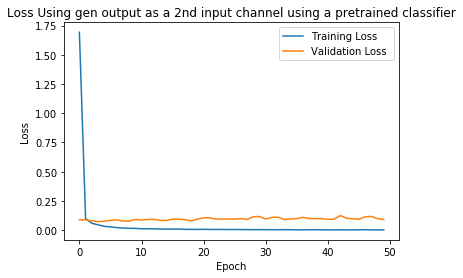

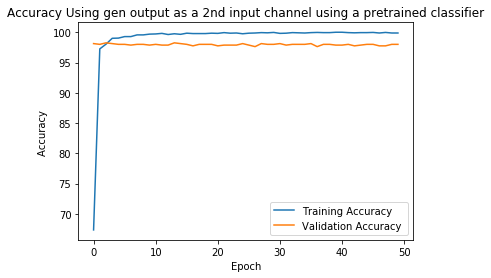

In [0]:
plt.rcParams["figure.figsize"] = (6,4)
plot_graph(model10_stats[0],model10_stats[2],epochs,"Loss ","feedback genout pre")
plot_graph(model10_stats[1],model10_stats[3],epochs,"Accuracy ","feedback genout pre")

In [0]:
print("Training losses",model10_stats[0])
print("Training accuracies",model10_stats[1])
print("Val losses",model10_stats[2])
print("Val acc",model10_stats[3])

Training losses [1.6926454610079522, 0.09917772193625568, 0.05902585388347505, 0.045879098100122064, 0.03302625159802847, 0.02793517097027506, 0.022439793441910303, 0.01861092462739907, 0.015971877635340203, 0.015299173652194438, 0.012462415934249294, 0.012192439149395794, 0.011589368561428273, 0.010084488582098854, 0.009659363207814749, 0.009349157601172919, 0.00938208824793401, 0.007152016770705813, 0.007046315526356921, 0.006391461821589474, 0.007788736220187272, 0.006034275446494574, 0.0062629232456674795, 0.006077235636355909, 0.005541877040923283, 0.00586435693587555, 0.004961759577963675, 0.004807385784235521, 0.004746225133128975, 0.004379020363974633, 0.004474438419923899, 0.003913406516148825, 0.004326689592180628, 0.004379480407538723, 0.0041670006340573315, 0.003139580574682441, 0.003593355021110257, 0.0036685831185295677, 0.0041033343094550225, 0.003449561961597282, 0.0026606861782520357, 0.0030712229599228077, 0.003286238916441108, 0.0025467591963924856, 0.002812596694443

In [0]:
accuracies_model10 = test_model(model10,criterion,"genout feedback")


Test loss: 0.2872 
Testing Accuracy: 754/800 (94%)
bag Class Accuracy: 39/40 (97.5%)
beer Class Accuracy: 37/40 (92.5%)
book Class Accuracy: 40/40 (100.0%)
case Class Accuracy: 39/40 (97.5%)
coffee Class Accuracy: 39/40 (97.5%)
cup Class Accuracy: 40/40 (100.0%)
deodorant Class Accuracy: 40/40 (100.0%)
eraser Class Accuracy: 38/40 (95.0%)
hole Class Accuracy: 39/40 (97.5%)
mouse Class Accuracy: 35/40 (87.5%)
mug Class Accuracy: 34/40 (85.0%)
sleep Class Accuracy: 35/40 (87.5%)
speaker Class Accuracy: 35/40 (87.5%)
spray Class Accuracy: 38/40 (95.0%)
stapler Class Accuracy: 37/40 (92.5%)
tape Class Accuracy: 36/40 (90.0%)
tea Class Accuracy: 39/40 (97.5%)
tissues Class Accuracy: 40/40 (100.0%)
umbrella Class Accuracy: 36/40 (90.0%)
watch Class Accuracy: 38/40 (95.0%)
[[39  0  0  0  0  1  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 1 37  1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1  0]
 [ 0  0 40  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0 39  0  0  0  1  0  0  

[90.98557692307692, 93.99038461538461, 93.8701923076923, 93.99038461538461, 94.11057692307692, 94.35096153846153, 94.23076923076923, 94.23076923076923, 94.23076923076923, 94.23076923076923]
/content/drive/My Drive/Colab Notebooks/Graphs/accperit_model6.png


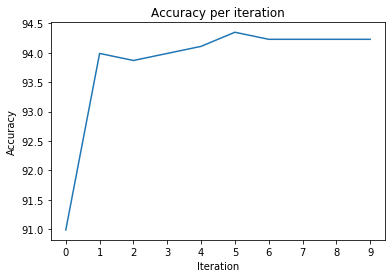

In [0]:
accuracy_per_iteration(accuracies_model10,"multiplicative")

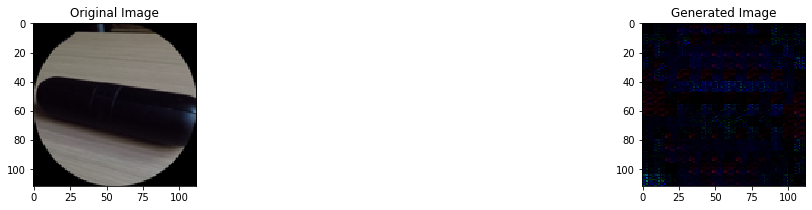

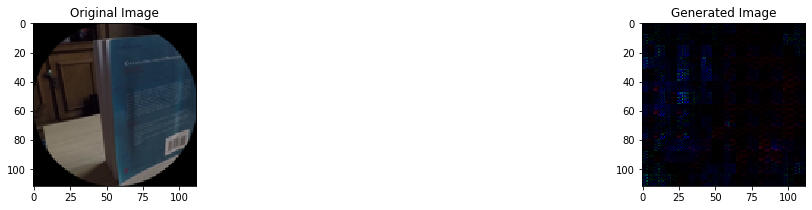

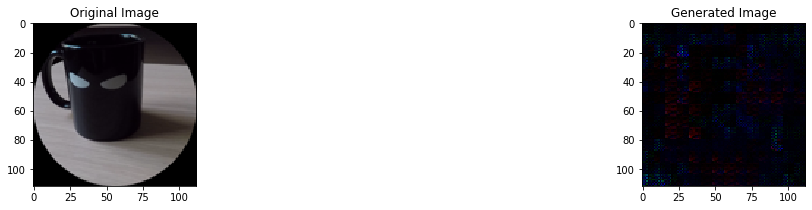

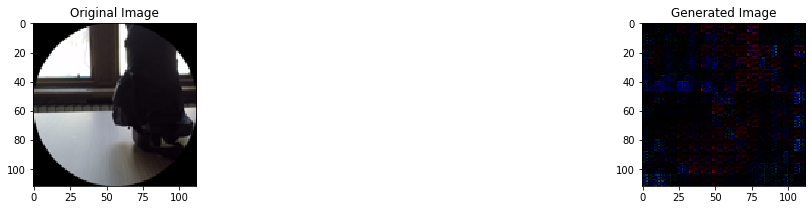

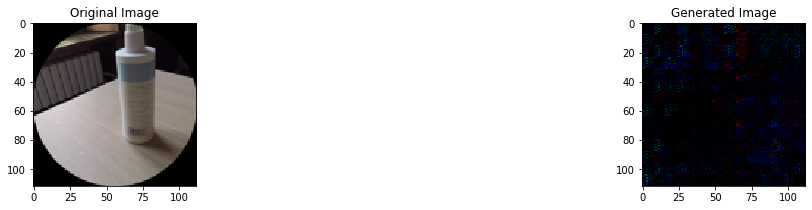

...

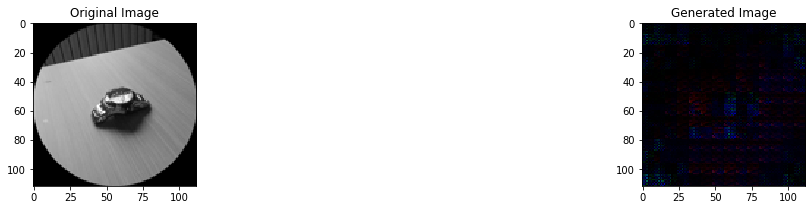

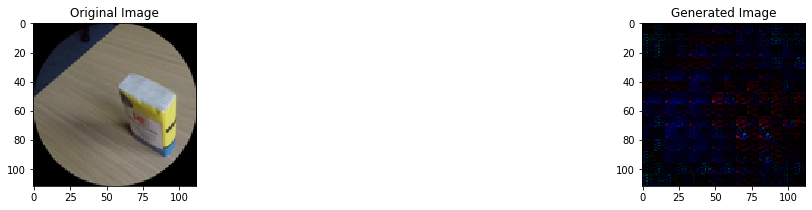

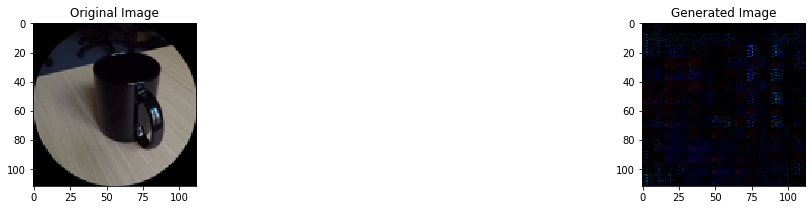

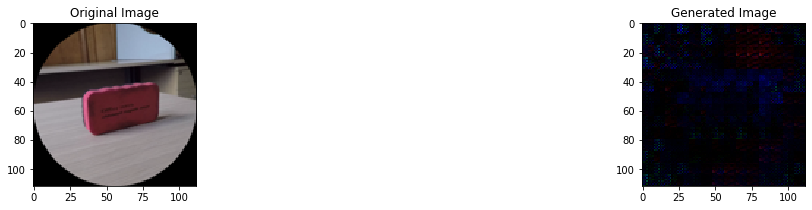

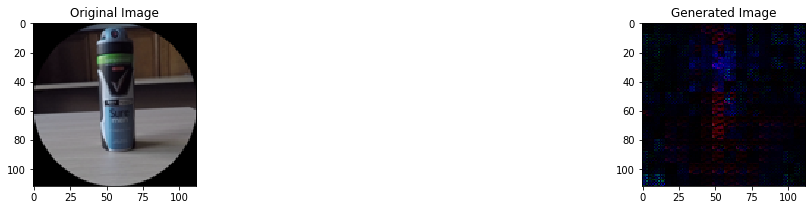

In [0]:
show_examples(model10,"genout feedback")

In [0]:
#for i in range(len(test_images)):
  #original = transforms.ToPILImage()(test_images[i].cpu())
  #generated_image = transforms.ToPILImage()(generated[i].cpu())
  #stacked_image = transforms.ToPILImage()(stacked_images[i].cpu())
  #display(original)
  #display(generated_image)